<a href="https://colab.research.google.com/github/bananighosh/Fall-2023-NYU-AI/blob/main/midterm/bg2502_take_at_home.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Problem Set 1 (Take Home) - 40 points

## PS 1.A - 20 points

In [this video](https://www.youtube.com/watch?v=ho6JXE3EbZ8) the author explains how to extract various visualizations of what CNNs learn. [Your course site](https://pantelis.github.io/artificial-intelligence/aiml-common/lectures/cnn/cnn-example-architectures/visualizing-what-convnets-learn.html) also covers the topic.

Using the [CIFAR-10 dataset](https://www.cs.toronto.edu/~kriz/cifar.html), train a ResNet-50 based CNN on the classification task of $K=9$ classes (filter out the class `ship`) and create the following visualizations for first, middle and last blocks of ResNet-50. You are free to select a class to showcase such visualizations.

* Visualizing intermediate convnet outputs (“intermediate activations”). This is useful to understand how successive convnet layers transform their input.

* Visualizing convnets filters. This is useful to understand precisely what visual pattern or concept each filter in a convnet is receptive to.

* Visualizing heatmaps of class activation in an image. This is useful to understand which part of an image where identified as belonging to a given class, and thus allows to localize objects in images.


In [ ]:
# Insert your code here
import numpy as np
import tensorflow as tf
from keras.models import Sequential, Model, load_model
from keras.layers import Flatten, Input, Dense, Add, Activation, Dropout, Conv2D, MaxPooling2D,GlobalAveragePooling2D, GlobalMaxPooling2D, AveragePooling2D, Resizing, ZeroPadding2D, BatchNormalization
from keras.optimizers import Adam, SGD
from keras.regularizers import l2
from keras.initializers import glorot_uniform
from keras.preprocessing import image
from keras.utils import to_categorical
from keras.preprocessing.image import ImageDataGenerator
from keras.preprocessing import image


from keras.applications import ResNet50
# from keras.applications.resnet50 import preprocess_input

from keras import backend as K

from keras.datasets import cifar10

from sklearn.preprocessing import LabelEncoder , OneHotEncoder

from matplotlib.pyplot import imshow
import matplotlib.pyplot as plt


### PS 1.A Data preprocessing

In [ ]:
# Load the CIFAR-10 dataset
(x_train, y_train), (x_test, y_test) = cifar10.load_data()

classes = len(np.unique(y_train))
classes

10

we know the number of classes and index associated from her https://www.tensorflow.org/api_docs/python/tf/keras/datasets/cifar10/load_data

The classes are:
| Label | Description |
|-------|-------------|
| 0     | airplane    |
| 1     | automobile  |
| 2     | bird        |
| 3     | cat         |
| 4     | deer        |
| 5     | dog         |
| 6     | frog        |
| 7     | horse       |
| 8     | ship        |
| 9     | truck       |

We have to exclude the class "ship with index 8"

In [ ]:
# preprocess the CIFAR-10 dataset
index = np.where(y_train == 8)
# Filter the dataset for 9 out of 10 classes (exclude "ship index 8" class)
class_to_exclude = 8  # Adjust this class to exclude "ship"
x_train = x_train[y_train.flatten() != class_to_exclude]/ 255.0
y_train = y_train[y_train != class_to_exclude].astype(int)
x_test = x_test[y_test.flatten() != class_to_exclude] / 255.0
y_test = y_test[y_test != class_to_exclude].astype(int)

# number of classes K=9
k = 9

In [ ]:
print(len(np.unique(y_train)), len(np.unique(x_train)), len(np.unique(y_test)), len(np.unique(x_test)))
print(x_train.shape, y_train.shape, x_test.shape, y_test.shape)

9 256 9 256
(45000, 32, 32, 3) (45000,) (9000, 32, 32, 3) (9000,)


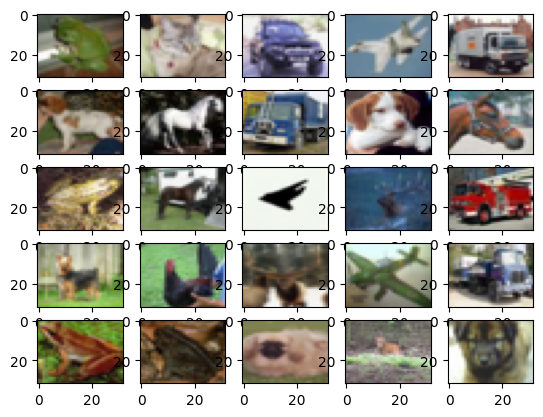

In [ ]:
# visualize data by plotting images
fig, ax = plt.subplots(5, 5)
k = 5

for i in range(5):
    for j in range(5):
        ax[i][j].imshow(x_test[k], aspect='auto')
        k += 1

plt.show()

In [ ]:
# A ResNet-50 model expects 224 × 224–pixel images
im_size = 224

x_train_resize = Resizing(height=im_size, width=im_size, crop_to_aspect_ratio=True)(x_train)
x_test_resize = Resizing(height=im_size, width=im_size, crop_to_aspect_ratio=True)(x_test)

In [ ]:
print(x_train_resize.shape, y_train.shape, x_test_resize.shape, y_test.shape)

(45000, 224, 224, 3) (45000,) (9000, 224, 224, 3) (9000,)


In [ ]:
# for y
y_labelencoder = LabelEncoder ()
y = y_labelencoder.fit_transform (y_train)
#print (y)

ytr=y_train.reshape(-1,1)
onehotencoder = OneHotEncoder()  #Converted  scalar output into vector output where the correct class will be 1 and other will be 0
y_train_norm= onehotencoder.fit_transform(ytr).toarray()

yts=y_test.reshape(-1,1)
# onehotencoder = OneHotEncoder()  #Converted  scalar output into vector output where the correct class will be 1 and other will be 0
y_test_norm= onehotencoder.transform(yts).toarray()

In [ ]:
print(x_train_resize.shape, y_train_norm.shape, x_test_resize.shape, y_test_norm.shape)

(45000, 224, 224, 3) (45000, 9) (9000, 224, 224, 3) (9000, 9)


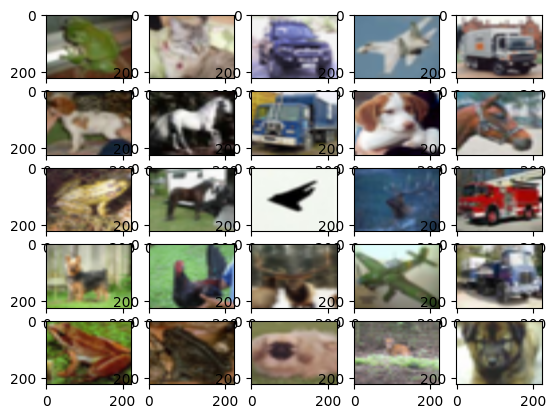

In [ ]:
# visualize data by plotting images
fig, ax = plt.subplots(5, 5)
k = 5

for i in range(5):
    for j in range(5):
        ax[i][j].imshow(x_test_resize[k], aspect='auto')
        k += 1

plt.show()

### PS 1A. Let's build the ResNet50 architecture

#### Identity or Skip path Block

In [ ]:
# x is input, y=F(x)
# identity block simply means input should be equal to output.
#  y = x + F(x)   the layers in a traditional network are learning the true output H(x)
# F(x) = y - x   the layers in a residual network are learning the residual F(x)
# Hence, the name: Residual Block.


def identity_block(X, f, filters, stage, block):
    """

    Arguments:
    X -- input of shape (m, height, width, channel)
    f -- shape of the middle CONV's window for the main path
    filters -- python list of integers, defining the number of filters in the CONV layers of the main path
    stage -- integer, used to name the layers, depending on their position in the network
    block -- string/character, used to name the layers, depending on their position in the network

    Returns:
    X -- output of the identity block, tensor of shape (n_H, n_W, n_C)
    """

    # defining name basis
    # conv_name_base = 'res' + str(stage) + block + '_branch'
    # bn_name_base = 'bn' + str(stage) + block + '_branch'
    conv_name_base = 'conv' + str(stage) + block + '_branch'
    bn_name_base = 'bn' + str(stage) + block + '_branch'

    # Retrieve Filters
    F1, F2, F3 = filters

    # Saving the input value.we need this later to add to the output.
    X_shortcut = X

    # First component of main path
    X = Conv2D(filters = F1, kernel_size = (1, 1), strides = (1,1), padding = 'valid', name = conv_name_base + '2a')(X)
    X = BatchNormalization(axis = 3, name = bn_name_base + '2a')(X)
    X = Activation('relu')(X)


    # Second component of main path (≈3 lines)
    X = Conv2D(filters = F2, kernel_size = (f, f), strides = (1,1), padding = 'same', name = conv_name_base + '2b')(X)
    X = BatchNormalization(axis = 3, name = bn_name_base + '2b')(X)
    X = Activation('relu')(X)

    # Third component of main path (≈2 lines)
    X = Conv2D(filters = F3, kernel_size = (1, 1), strides = (1,1), padding = 'valid', name = conv_name_base + '2c')(X)
    X = BatchNormalization(axis = 3, name = bn_name_base + '2c')(X)

    # Final step: Add shortcut value to main path, and pass it through a RELU activation
    X = Add()([X, X_shortcut])
    X = Activation('relu')(X)


    return X

#### Convolutional BLock

In [ ]:
def convolutional_block(X, f, filters, stage, block, s = 2):

    # defining name basis
    # conv_name_base = 'res' + str(stage) + block + '_branch'
    # bn_name_base = 'bn' + str(stage) + block + '_branch'

    conv_name_base = 'conv' + str(stage) + block + '_branch'
    bn_name_base = 'bn' + str(stage) + block + '_branch'

    # Retrieve Filters
    F1, F2, F3 = filters

    # Save the input value
    X_shortcut = X


    # First layer
    X = Conv2D(F1, (1, 1), strides = (s,s), name = conv_name_base + '2a')(X) # 1,1 is filter size
    X = BatchNormalization(axis = 3, name = bn_name_base + '2a')(X)  # normalization on channels
    X = Activation('relu')(X)


    # Second layer  (f,f)=3*3 filter by default
    X = Conv2D(filters = F2, kernel_size = (f, f), strides = (1,1), padding = 'same', name = conv_name_base + '2b')(X)
    X = BatchNormalization(axis = 3, name = bn_name_base + '2b')(X)
    X = Activation('relu')(X)


    # Third layer
    X = Conv2D(filters = F3, kernel_size = (1, 1), strides = (1,1), padding = 'valid', name = conv_name_base + '2c')(X)
    X = BatchNormalization(axis = 3, name = bn_name_base + '2c')(X)


    ##### SHORTCUT PATH ####
    X_shortcut = Conv2D(filters = F3, kernel_size = (1, 1), strides = (s,s), padding = 'valid', name = conv_name_base + '1')(X_shortcut)
    X_shortcut = BatchNormalization(axis = 3, name = bn_name_base + '1')(X_shortcut)

    # Final step: Add shortcut value here, and pass it through a RELU activation
    X = Add()([X, X_shortcut])
    X = Activation('relu')(X)

    return X

In [ ]:
#Each ResNet block is either 2 layer deep
def ResNet50custom(input_shape=(64, 64, 3), classes=3):
    """
    Implementation of the ResNet50 architecture:
    CONV2D -> BATCHNORM -> RELU -> MAXPOOL -> CONVBLOCK -> IDBLOCK*2 -> CONVBLOCK -> IDBLOCK*3
    -> CONVBLOCK -> IDBLOCK*5 -> CONVBLOCK -> IDBLOCK*2 -> AVGPOOL -> TOPLAYER

    """

    # Define the input as a tensor with shape input_shape
    X_input = Input(input_shape)

    # Zero-Padding
    X = ZeroPadding2D((3, 3))(X_input) #3,3 padding

    # Stage 1
    X = Conv2D(64, (7, 7), strides=(2, 2), name='conv1')(X) #64 filters of 7*7
    X = BatchNormalization(axis=3, name='bn_conv1')(X) #batchnorm applied on channels
    X = Activation('relu')(X)
    X = MaxPooling2D((3, 3), strides=(2, 2))(X) #window size is 3*3

    # Stage 2
    X = convolutional_block(X, f=3, filters=[64, 64, 256], stage=2, block='a', s=1)
    # convolutional_block is a function defined above. Convolutional_block have 3 layers.
    #filters=[64, 64, 256] first 64 is for 1st layer and 2nd 64 is for 2nd layer and 256 is for 3rd layer of convultional block
    # below are the conv layers from convolutional_block function
    #X = Conv2D(F1, (1, 1), strides = (s,s), name = conv_name_base + '2a')(X)
    #X = Conv2D(F2, kernel_size = (f, f), strides = (1,1), padding = 'same', name = conv_name_base + '2b')(X)
    #X = Conv2D(F3, (1, 1), strides = (s,s), name = conv_name_base + '2a')(X)

    X = identity_block(X, 3, [64, 64, 256], stage=2, block='b')
    #X = Conv2D(filters = F1, kernel_size = (1, 1), strides = (1,1), padding = 'valid', name = conv_name_base + '2a')(X)
    #X = Conv2D(filters = F2, kernel_size = (f, f), strides = (1,1), padding = 'same', name = conv_name_base + '2b')(X)
    #X = Conv2D(filters = F3, kernel_size = (1, 1), strides = (1,1), padding = 'valid', name = conv_name_base + '2c')(X)

    X = identity_block(X, 3, [64, 64, 256], stage=2, block='c')
    #X = Conv2D(filters = F1, kernel_size = (1, 1), strides = (1,1), padding = 'valid', name = conv_name_base + '2a')(X)
    #X = Conv2D(filters = F2, kernel_size = (f, f), strides = (1,1), padding = 'same', name = conv_name_base + '2b')(X)
    #X = Conv2D(filters = F3, kernel_size = (1, 1), strides = (1,1), padding = 'valid', name = conv_name_base + '2c')(X)


    ### START CODE HERE ###

    # Stage 3
    X = convolutional_block(X, f = 3, filters = [128, 128, 512], stage = 3, block='a', s = 2)
    X = identity_block(X, 3, [128, 128, 512], stage=3, block='b')
    X = identity_block(X, 3, [128, 128, 512], stage=3, block='c')
    X = identity_block(X, 3, [128, 128, 512], stage=3, block='d')

    # Stage 4
    X = convolutional_block(X, f = 3, filters = [256, 256, 1024], stage = 4, block='a', s = 2)
    X = identity_block(X, 3, [256, 256, 1024], stage=4, block='b')
    X = identity_block(X, 3, [256, 256, 1024], stage=4, block='c')
    X = identity_block(X, 3, [256, 256, 1024], stage=4, block='d')
    X = identity_block(X, 3, [256, 256, 1024], stage=4, block='e')
    X = identity_block(X, 3, [256, 256, 1024], stage=4, block='f')

    # Stage 5
    X = convolutional_block(X, f = 3, filters = [512, 512, 2048], stage = 5, block='a', s = 2)
    X = identity_block(X, 3, [512, 512, 2048], stage=5, block='b')
    X = identity_block(X, 3, [512, 512, 2048], stage=5, block='c')

    # AVGPOOL
    X = AveragePooling2D((2,2), name="avg_pool")(X)

    ### END CODE HERE ###

    # output layer
    X = Flatten()(X)
    X = Dense(classes, activation='softmax', name='fc' + str(classes), kernel_initializer = glorot_uniform(seed=0))(X)


    # Create model
    model = Model(inputs = X_input, outputs = X, name='ResNet50')

    return model

In [ ]:
im_size = 224
k =9
model = ResNet50custom(input_shape = (im_size, im_size, 3), classes = k)

In [ ]:
model.summary()

Model: "ResNet50"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 zero_padding2d (ZeroPaddin  (None, 230, 230, 3)          0         ['input_1[0][0]']             
 g2D)                                                                                             
                                                                                                  
 conv1 (Conv2D)              (None, 112, 112, 64)         9472      ['zero_padding2d[0][0]']      
                                                                                                  
 bn_conv1 (BatchNormalizati  (None, 112, 112, 64)         256       ['conv1[0][0]']        

### PS1A. ResNet50 non custom

In [ ]:
# Load ResNet-50 with custom input size
im_size = 224

base_model = ResNet50(input_shape=(im_size, im_size, 3), include_top=False, weights=None)

# Adjust the feature map size before average pooling
x = base_model.layers[-1].output
x = AveragePooling2D(pool_size=(2, 2))(x)  # Reduce feature map size to 1x1
x = Flatten()(x)
output = Dense(9, activation='softmax')(x)

# Create a new model
model = Model(inputs=base_model.input, outputs=output)

In [ ]:
model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 conv1_pad (ZeroPadding2D)   (None, 230, 230, 3)          0         ['input_1[0][0]']             
                                                                                                  
 conv1_conv (Conv2D)         (None, 112, 112, 64)         9472      ['conv1_pad[0][0]']           
                                                                                                  
 conv1_bn (BatchNormalizati  (None, 112, 112, 64)         256       ['conv1_conv[0][0]']          
 on)                                                                                          

In [ ]:
# Set hyperparameters
learning_rate = 0.001
beta1 = 0.9
beta2 = 0.999
epsilon = 1e-8
num_iterations = 1000
# optimizer = Adam(learning_rate=learning_rate, beta_1=beta1, beta_2=beta2, epsilon=1e-8)
optimizer = SGD(learning_rate=learning_rate, momentum=0.9, nesterov=True)
model.compile(optimizer=optimizer, loss='categorical_crossentropy', metrics=['accuracy'])

In [ ]:
# Define a custom callback to track validation loss
class ValidationLoss(tf.keras.callbacks.Callback):
    def __init__(self):
        super(ValidationLoss, self).__init__()
        self.validation_losses = []

    def on_epoch_end(self, epoch, logs=None):
        self.validation_losses.append(logs['val_loss'])

# Define the custom learning rate scheduler
class CustomLRScheduler(tf.keras.callbacks.Callback):
    def on_epoch_begin(self, epoch, logs=None):
        new_lr = 0.001 / np.sqrt(epoch+1)
        K.set_value(self.model.optimizer.lr, new_lr)
        print(f'Epoch {epoch + 1}: Learning Rate = {new_lr}')

In [ ]:
# x_train_resize.shape, y_train_norm.shape, x_test_resize.shape, y_test_norm.shape
# model.fit(x_train_resize, x_train_resize, epochs = 10, batch_size = 128)
# model.fit(x_train_resize, y_train_norm, epochs=45, batch_size = 128, validation_data=(x_test_resize, x_test_resize), verbose=0)
# Create a custom callback to track validation loss
val_loss_callback = ValidationLoss()
lr_scheduler = CustomLRScheduler()

model.fit(
    x=x_train_resize,  # Your training data
    y=y_train_norm,  # Your training labels
    batch_size=64,
    epochs=5,
    steps_per_epoch=10,
    validation_data=(x_test_resize, y_test_norm),
    callbacks=[val_loss_callback, lr_scheduler]
    # Other parameters like callbacks, verbose, etc.
)


model.save('model_my_custom_resnet50_aug2.h5')

Epoch 1: Learning Rate = 0.001
Epoch 1/5
10/10 [==============================] - 245s 26s/step - loss: 2.6025 - accuracy: 0.3016 - val_loss: 10.6501 - val_accuracy: 0.1303
Epoch 2: Learning Rate = 0.0007071067811865475
Epoch 2/5
10/10 [==============================] - 249s 27s/step - loss: 2.8719 - accuracy: 0.2797 - val_loss: 4.2490 - val_accuracy: 0.1624
Epoch 3: Learning Rate = 0.0005773502691896258
Epoch 3/5
10/10 [==============================] - 244s 26s/step - loss: 2.9668 - accuracy: 0.2578 - val_loss: 3.3308 - val_accuracy: 0.1773
Epoch 4: Learning Rate = 0.0005
Epoch 4/5
10/10 [==============================] - 254s 27s/step - loss: 2.1763 - accuracy: 0.3219 - val_loss: 5.5174 - val_accuracy: 0.1897
Epoch 5: Learning Rate = 0.0004472135954999579
Epoch 5/5
10/10 [==============================] - 245s 26s/step - loss: 2.5679 - accuracy: 0.2703 - val_loss: 4.3503 - val_accuracy: 0.1356


/Users/banani/Library/Python/3.9/lib/python/site-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [ ]:
model.save('model_resnet50_lr3.h5')

In [ ]:
## Data augmentation

batch_size = 32
data_generator = tf.keras.preprocessing.image.ImageDataGenerator(
  width_shift_range=0.1, height_shift_range=0.1, horizontal_flip=True)

train_generator = data_generator.flow(x_train_resize,
                                      y_train_norm,
                                      batch_size)
steps_per_epoch = x_train_resize.shape[0] // batch_size



In [ ]:
r = model.fit_generator(train_generator,
              validation_data=(x_test_resize, y_test_norm),
              batch_size=64,
              epochs=5,
              steps_per_epoch=10,
              callbacks=[val_loss_callback, lr_scheduler]
              )

model.save('model_resnet50_aug4.h5')

Epoch 1: Learning Rate = 0.001
Epoch 1/5
10/10 [==============================] - 219s 24s/step - loss: 3.6517 - accuracy: 0.2594 - val_loss: 4.6119 - val_accuracy: 0.1868
Epoch 2: Learning Rate = 0.0007071067811865475
Epoch 2/5
10/10 [==============================] - 214s 23s/step - loss: 4.8421 - accuracy: 0.2062 - val_loss: 2.7708 - val_accuracy: 0.1488
Epoch 3: Learning Rate = 0.0005773502691896258
Epoch 3/5
10/10 [==============================] - 217s 24s/step - loss: 4.4187 - accuracy: 0.2562 - val_loss: 2.0583 - val_accuracy: 0.2217
Epoch 4: Learning Rate = 0.0005
Epoch 4/5
10/10 [==============================] - 219s 24s/step - loss: 3.4729 - accuracy: 0.2562 - val_loss: 2.2416 - val_accuracy: 0.1591
Epoch 5: Learning Rate = 0.0004472135954999579
Epoch 5/5
10/10 [==============================] - 217s 24s/step - loss: 2.9785 - accuracy: 0.3063 - val_loss: 2.1482 - val_accuracy: 0.1852


In [ ]:
r = model.fit(train_generator,
              validation_data=(x_test_resize, y_test_norm),
              batch_size=64,
              epochs=10,
              steps_per_epoch=10,
              callbacks=[val_loss_callback, lr_scheduler]
              )

model.save('model_resnet50_aug3.h5')

Epoch 1/10
10/10 [==============================] - 314s 35s/step - loss: 2.0968 - accuracy: 0.2250 - val_loss: 2.2848 - val_accuracy: 0.2092
Epoch 2/10
10/10 [==============================] - 201s 22s/step - loss: 2.0053 - accuracy: 0.2594 - val_loss: 2.4074 - val_accuracy: 0.2038
Epoch 3/10
10/10 [==============================] - 202s 22s/step - loss: 2.1640 - accuracy: 0.2188 - val_loss: 2.2850 - val_accuracy: 0.2204
Epoch 4/10
10/10 [==============================] - 205s 22s/step - loss: 2.2046 - accuracy: 0.2281 - val_loss: 2.3327 - val_accuracy: 0.2210
Epoch 5/10
10/10 [==============================] - 213s 23s/step - loss: 2.0892 - accuracy: 0.2594 - val_loss: 2.2663 - val_accuracy: 0.2052
Epoch 6/10
10/10 [==============================] - 199s 22s/step - loss: 2.1547 - accuracy: 0.2313 - val_loss: 2.2064 - val_accuracy: 0.2120
Epoch 7/10
10/10 [==============================] - 200s 22s/step - loss: 2.0995 - accuracy: 0.2781 - val_loss: 2.2011 - val_accuracy: 0.2298
Epoch 

### Predict the architecture

In [ ]:
predictions = model.predict(x_test_resize)

282/282 [==============================] - 190s 671ms/step


In [ ]:
# Visualize predictions on test data
predicted_labels = (predictions > 0.5).astype(int)
sample_images = x_test_resize[:10]
sample_labels = y_test_norm[:10]

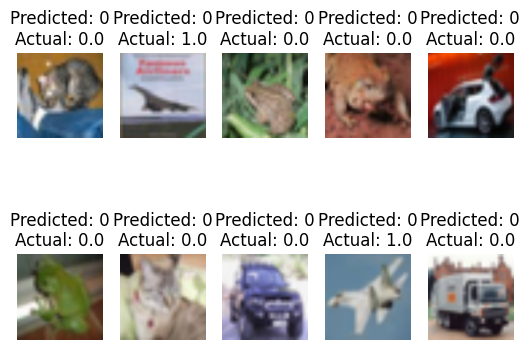

In [ ]:
for i in range(10):
    plt.subplot(2, 5, i + 1)
    plt.imshow(sample_images[i])
    plt.title(f'Predicted: {predicted_labels[i][0]}\nActual: {sample_labels[i][0]}')
    plt.axis('off')

plt.show()

### PS1A. Visualize Intermediate Activations

In [ ]:
img_path='refs/dog_1.jpg'
# img_path='refs/dog.215.jpg'

# We preprocess the image into a 4D tensor
from keras.preprocessing import image
import numpy as np

im_size = 224

img = tf.keras.utils.load_img(img_path, target_size=(im_size, im_size))
img_tensor = tf.keras.utils.img_to_array(img)
img_tensor = np.expand_dims(img_tensor, axis=0)
# the model was trained on inputs
# that were preprocessed in the following way:
img_tensor /= 255.

# Its shape is (1, 224, 224, 3)
print(img_tensor.shape)

(1, 224, 224, 3)


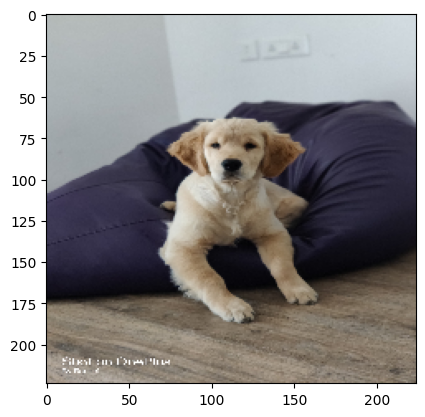

In [ ]:
import matplotlib.pyplot as plt

plt.imshow(img_tensor[0])
plt.show()

#### Chosen layers

In [ ]:
layers_to_visualize = [model.get_layer('conv1_relu'),
                       model.get_layer('conv3_block2_2_relu'),
                       model.get_layer('conv5_block3_2_relu')]

for layer in layers_to_visualize:
    print(layer.name)

conv1_relu
conv3_block2_2_relu
conv5_block3_2_relu


In [ ]:
act_input1 = model.input
# Extracts the outputs of the top 50 layers:
# layer_outputs = [layer.output for layer in model.layers[1:51]]
layer_outputs1 = [layer.output for layer in layers_to_visualize]

# First block :  conv1
# Middle block:  conv2c_branch2b
# Last block:    conv5c_branch2c

# layer_outputs = [layer.output for layer in layers_to_visualize]
# Creates a model that will return these outputs, given the model input:
activation_model1 = Model(inputs=act_input1, outputs=layer_outputs1)
activation_model1.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 conv1_pad (ZeroPadding2D)   (None, 230, 230, 3)          0         ['input_1[0][0]']             
                                                                                                  
 conv1_conv (Conv2D)         (None, 112, 112, 64)         9472      ['conv1_pad[0][0]']           
                                                                                                  
 conv1_bn (BatchNormalizati  (None, 112, 112, 64)         256       ['conv1_conv[0][0]']          
 on)                                                                                        

#### First Layer Activation

1/1 [==============================] - 0s 57ms/step
(1, 112, 112, 64)
(1, 112, 112, 64)
(1, 28, 28, 128)
(1, 7, 7, 512)


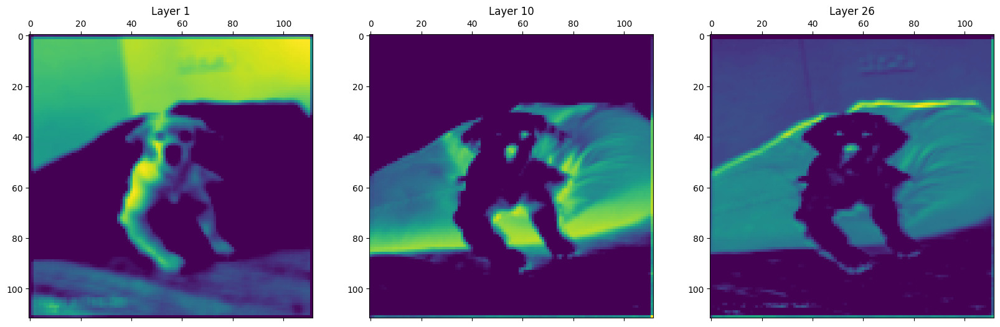

In [ ]:
activations = activation_model1.predict([img_tensor])

first_layer_activation = activations[0]
print(first_layer_activation.shape)

for activation in activations:
    print(activation.shape)

# for i in range(3):  # Loop through the channels
#     plt.matshow(first_layer_activation[0, :, :, i], cmap='viridis')
#     plt.show()
# plt.matshow(first_layer_activation[0, :, :, 0], cmap='viridis')
# plt.show()
# plt.matshow(first_layer_activation[0, :, :, 3], cmap='viridis')
# plt.show()

fig, axes = plt.subplots(1, 3,  figsize=(20, 8))

# Display the first activation
axes[0].matshow(first_layer_activation[0, :, :, 6], cmap='viridis')
axes[0].set_title('Layer 1')

# Display the second activation
axes[1].matshow(first_layer_activation[0, :, :, 10], cmap='viridis')
axes[1].set_title('Layer 10')

# Display the second activation
axes[2].matshow(first_layer_activation[0, :, :, 15], cmap='viridis')
axes[2].set_title('Layer 26')

# Show the subplots
plt.show()

This one looks like a “bright green dots” detector, useful to encode dog eyes and nose and it gets further clear as we go deeper.

At this point, let’s go and plot a complete visualization of all the activations in the network.

#### Middle Layer Activation

1/1 [==============================] - 0s 57ms/step
(1, 28, 28, 128)
(1, 112, 112, 64)
(1, 28, 28, 128)
(1, 7, 7, 512)


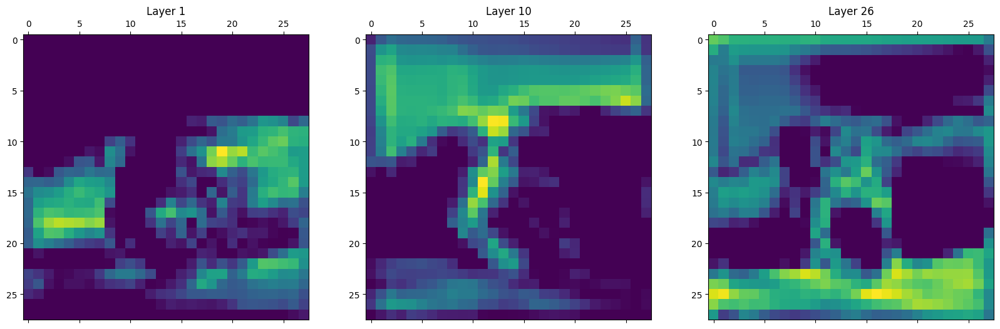

In [ ]:
activations = activation_model1.predict([img_tensor])

middle_layer_activation = activations[1]
print(middle_layer_activation.shape)

for activation in activations:
    print(activation.shape)

fig, axes = plt.subplots(1, 3,  figsize=(20, 8))

# Display the first activation
axes[0].matshow(middle_layer_activation[0, :, :, 6], cmap='viridis')
axes[0].set_title('Layer 1')

# Display the second activation
axes[1].matshow(middle_layer_activation[0, :, :, 10], cmap='viridis')
axes[1].set_title('Layer 10')

# Display the second activation
axes[2].matshow(middle_layer_activation[0, :, :, 15], cmap='viridis')
axes[2].set_title('Layer 26')

# Show the subplots
plt.show()

This one looks like the edges of the dog are more defined and some contours noticed in the deeper layers

At this point, let’s go and plot a complete visualization of all the activations in the network.

#### Last Layer Activation

1/1 [==============================] - 0s 51ms/step
(1, 112, 112, 64)
(1, 112, 112, 64)
(1, 28, 28, 128)
(1, 7, 7, 512)


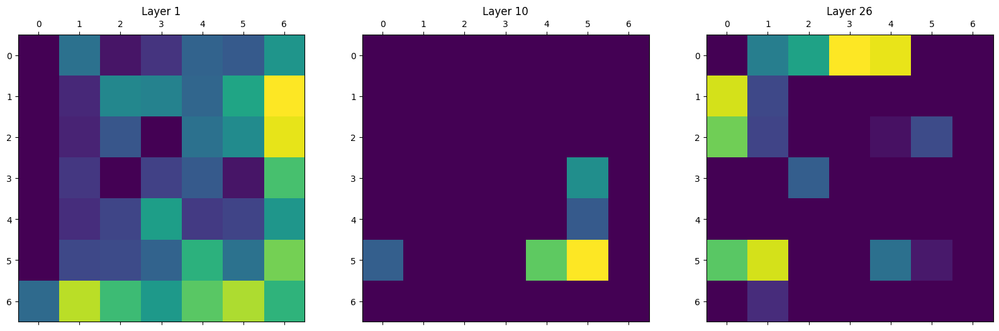

In [ ]:
activations = activation_model1.predict([img_tensor])

last_layer_activation = activations[2]
print(first_layer_activation.shape)

for activation in activations:
    print(activation.shape)

fig, axes = plt.subplots(1, 3,  figsize=(20, 8))

# Display the first activation
axes[0].matshow(last_layer_activation[0, :, :, 1], cmap='viridis')
axes[0].set_title('Layer 1')

# Display the second activation
axes[1].matshow(last_layer_activation[0, :, :, 11], cmap='viridis')
axes[1].set_title('Layer 10')

# Display the second activation
axes[2].matshow(last_layer_activation[0, :, :, 15], cmap='viridis')
axes[2].set_title('Layer 26')

# Show the subplots
plt.show()

/var/folders/xy/1x8f1vlx569_ch145p3563j80000gn/T/ipykernel_13280/1408363524.py:37: RuntimeWarning: invalid value encountered in cast
  channel_image = np.clip(channel_image, 0, 255).astype('uint8')


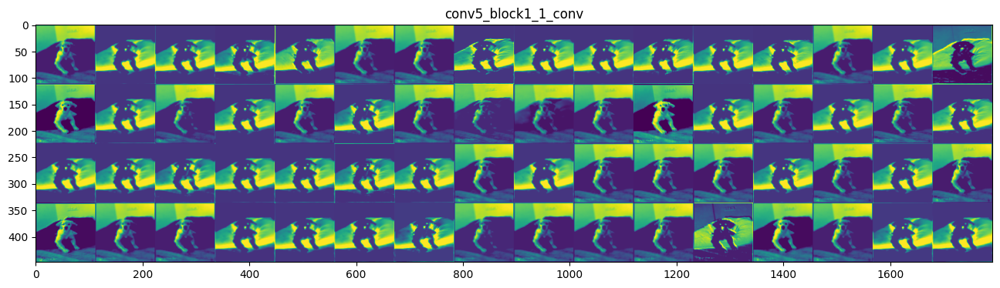

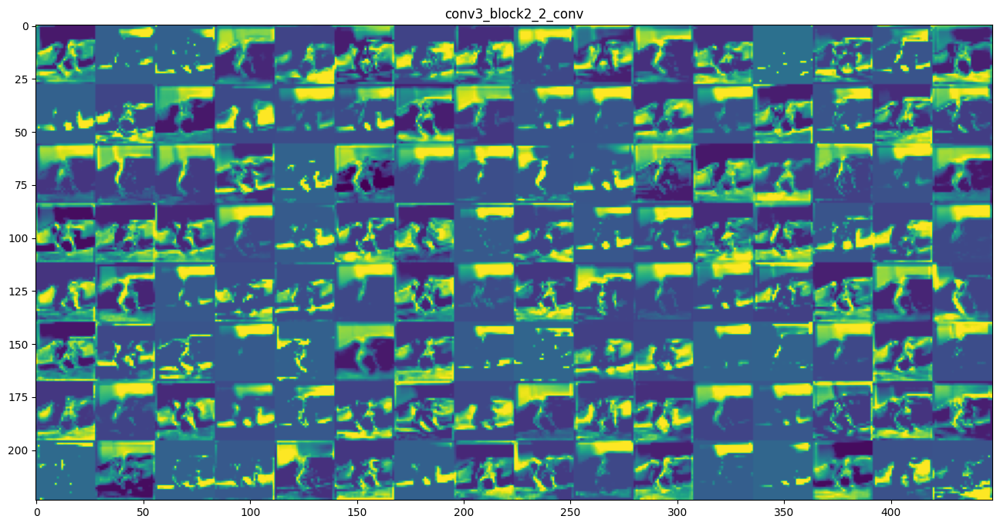

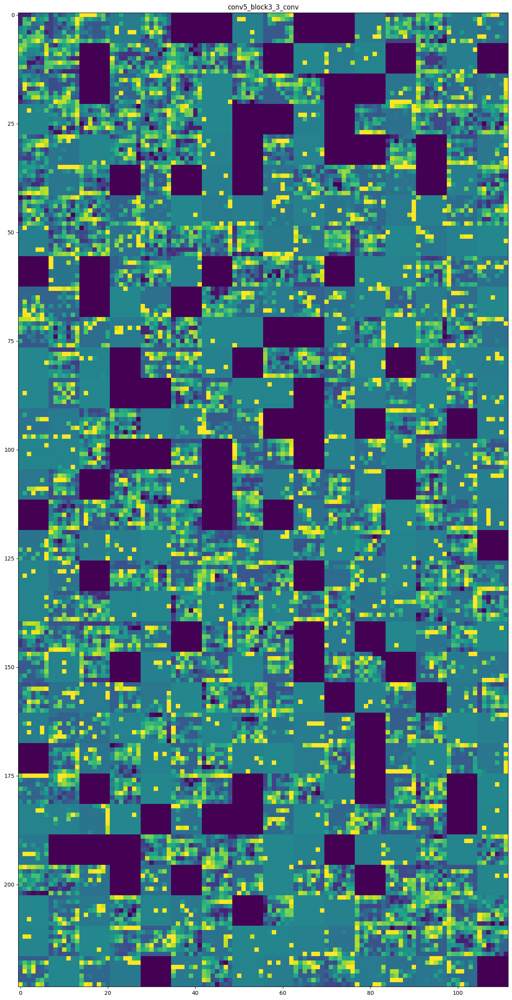

In [ ]:
# These are the names of the layers, so can have them as part of our plot
layer_names = []
# layer_names = layers_to_visualize
# for layer in model.layers[:50]:
#     layer_names.append(layer.name)
# for layer in layers_to_visualize:
#     print(layer.name)
#     layer_names.append(layer.name)

layer_names = layers_to_visualize

images_per_row = 16

# Now let's display our feature maps
for layer_name, layer_activation in zip(layer_names, activations):
    # This is the number of features in the feature map
    n_features = layer_activation.shape[-1]

    # The feature map has shape (1, size, size, n_features)
    size = layer_activation.shape[1]

    # We will tile the activation channels in this matrix
    n_cols = n_features // images_per_row
    display_grid = np.zeros((size * n_cols, images_per_row * size))

    # We'll tile each filter into this big horizontal grid
    for col in range(n_cols):
        for row in range(images_per_row):
            channel_image = layer_activation[0,
                                             :, :,
                                             col * images_per_row + row]
            # Post-process the feature to make it visually palatable
            channel_image -= channel_image.mean()
            channel_image /= channel_image.std()
            channel_image *= 64
            channel_image += 128
            channel_image = np.clip(channel_image, 0, 255).astype('uint8')
            display_grid[col * size : (col + 1) * size,
                         row * size : (row + 1) * size] = channel_image

    # Display the grid
    scale = 1. / size
    plt.figure(figsize=(scale * display_grid.shape[1],
                        scale * display_grid.shape[0]))
    plt.title(layer_name)
    plt.grid(False)
    plt.imshow(display_grid, aspect='auto', cmap='viridis')

plt.show()

Please scroll to view all the plots

### Ignore - OLD_ CustomResNET50 Visualizing intermediate activations
Chose class Dog

In [ ]:
# import tensorflow as tf
model = tf.keras.models.load_model('model_my_custom_resnet50_lr.h5')
# model.summary()

In [ ]:
# img_path = 'dogscats/subset/test/cats/cat.1700.jpg'
img_path='refs/dog_1.jpg'
# img_path='refs/dog.215.jpg'

# We preprocess the image into a 4D tensor
from keras.preprocessing import image
import numpy as np

im_size = 224

img = tf.keras.utils.load_img(img_path, target_size=(im_size, im_size))
img_tensor = tf.keras.utils.img_to_array(img)
img_tensor = np.expand_dims(img_tensor, axis=0)
# Remember that the model was trained on inputs
# that were preprocessed in the following way:
img_tensor /= 255.

# Its shape is (1, 150, 150, 3)
print(img_tensor.shape)

(1, 224, 224, 3)


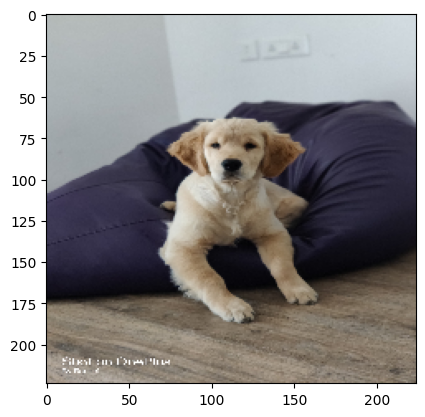

In [ ]:
import matplotlib.pyplot as plt

plt.imshow(img_tensor[0])
plt.show()

In [ ]:
# layers = model.layers
# # for layer in layers:
# #     print(layer.name)
# # filters, biases = model.layers[2]._get_trainable_state
# layers_to_visualize = [model.get_layer('conv1'), model.get_layer('conv2c_branch2b'), model.get_layer('conv5c_branch2c')]

# layers_to_visualize = [model.get_layer('conv1_relu'),
#                        model.get_layer('conv3_block2_2_relu'),
#                        model.get_layer('conv5_block3_2_relu')]

layers_to_visualize = [model.get_layer('conv1'),
                       model.get_layer('conv3a_branch2b'),
                       model.get_layer('conv5c_branch2c')]
# # print(layers[2].name, filters.shape)
# for layer in model.layers:
#     print(layer.name)
for layer in layers_to_visualize:
    print(layer.name)

conv1
conv3a_branch2b
conv5c_branch2c


In [ ]:
act_input = model.input
# Extracts the outputs of the top 50 layers:
# layer_outputs = [layer.output for layer in model.layers[1:51]]
layer_outputs = [layer.output for layer in layers_to_visualize]

# First block :  conv1
# Middle block:  conv2c_branch2b
# Last block:    conv5c_branch2c

# layer_outputs = [layer.output for layer in layers_to_visualize]
# Creates a model that will return these outputs, given the model input:
activation_model = Model(inputs=act_input, outputs=layer_outputs)


In [ ]:
activation_model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 zero_padding2d (ZeroPaddin  (None, 230, 230, 3)          0         ['input_1[0][0]']             
 g2D)                                                                                             
                                                                                                  
 conv1 (Conv2D)              (None, 112, 112, 64)         9472      ['zero_padding2d[0][0]']      
                                                                                                  
 bn_conv1 (BatchNormalizati  (None, 112, 112, 64)         256       ['conv1[0][0]']           

#### First Layer activation

1/1 [==============================] - 0s 49ms/step
(1, 112, 112, 64)
(1, 112, 112, 64)
(1, 28, 28, 128)
(1, 7, 7, 2048)


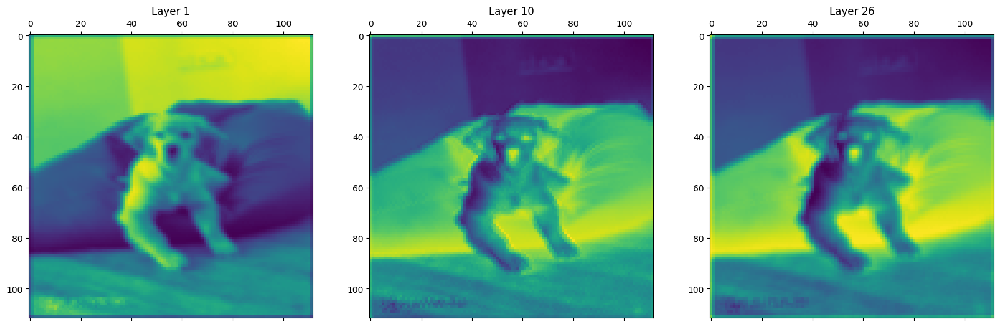

In [ ]:
# This will return a list of 5 Numpy arrays:
# one array per layer activation

activations = activation_model.predict([img_tensor])

first_layer_activation = activations[0]
print(first_layer_activation.shape)

for activation in activations:
    print(activation.shape)

# for i in range(3):  # Loop through the channels
#     plt.matshow(first_layer_activation[0, :, :, i], cmap='viridis')
#     plt.show()
# plt.matshow(first_layer_activation[0, :, :, 0], cmap='viridis')
# plt.show()
# plt.matshow(first_layer_activation[0, :, :, 3], cmap='viridis')
# plt.show()

fig, axes = plt.subplots(1, 3,  figsize=(20, 8))

# Display the first activation
axes[0].matshow(first_layer_activation[0, :, :, 4], cmap='viridis')
axes[0].set_title('Layer 1')

# Display the second activation
axes[1].matshow(first_layer_activation[0, :, :, 13], cmap='viridis')
axes[1].set_title('Layer 10')

# Display the second activation
axes[2].matshow(first_layer_activation[0, :, :, 49], cmap='viridis')
axes[2].set_title('Layer 26')

# Show the subplots
plt.show()

In [ ]:
# for i in range(64):

#     plt.matshow(first_layer_activation[0, :, :, i], cmap='viridis')
#     plt.show()

This one looks like a “bright green dot” detector, useful to encode dog eyes and nose.

At this point, let’s go and plot a complete visualization of all the activations in the network.

#### Middle Layer activation

1/1 [==============================] - 0s 86ms/step
(1, 28, 28, 128)


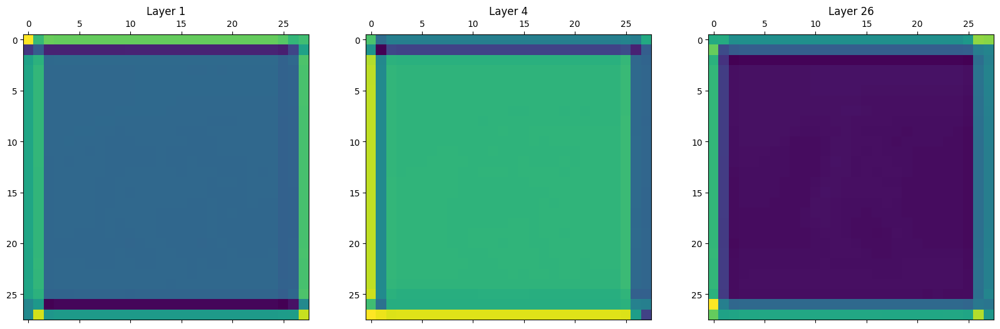

In [ ]:
activations = activation_model.predict([img_tensor])

middle_layer_activation = activations[1]
print(middle_layer_activation.shape)

# for activation in activations:
#     print(activation.shape)

# plt.matshow(middle_layer_activation[0, :, :, 1], cmap='viridis')
# plt.show()

fig, axes = plt.subplots(1, 3, figsize=(20, 8))

# Display the first activation
axes[0].matshow(middle_layer_activation[0, :, :, 1], cmap='viridis')
axes[0].set_title('Layer 1')

# Display the second activation
axes[1].matshow(middle_layer_activation[0, :, :, 4], cmap='viridis')
axes[1].set_title('Layer 4')

# Display the second activation
axes[2].matshow(middle_layer_activation[0, :, :, 26], cmap='viridis')
axes[2].set_title('Layer 26')

# Show the subplots
plt.show()

#### Last Layer activation

1/1 [==============================] - 0s 54ms/step
(1, 7, 7, 2048)


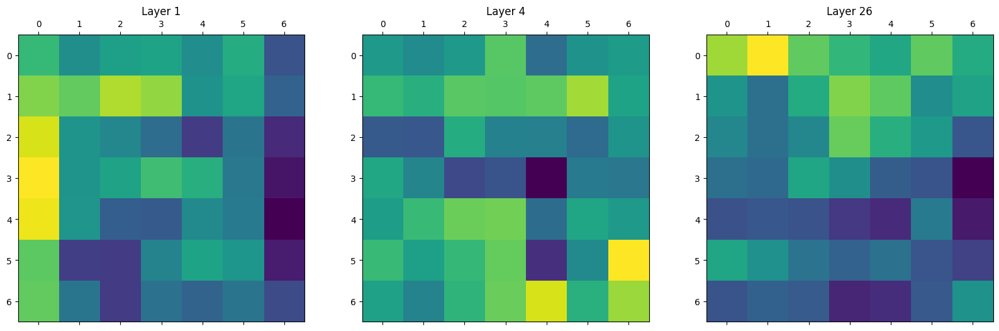

In [ ]:
activations = activation_model.predict([img_tensor])

last_layer_activation = activations[2]
print(last_layer_activation.shape)

# plt.matshow(last_layer_activation[0, :, :, 1], cmap='viridis')
# plt.show()
# plt.matshow(last_layer_activation[0, :, :, 26], cmap='viridis')
# plt.show()

fig, axes = plt.subplots(1, 3, figsize=(20, 8))

# Display the first activation
axes[0].matshow(last_layer_activation[0, :, :, 1], cmap='viridis')
axes[0].set_title('Layer 1')

# Display the second activation
axes[1].matshow(last_layer_activation[0, :, :, 4], cmap='viridis')
axes[1].set_title('Layer 4')

# Display the second activation
axes[2].matshow(last_layer_activation[0, :, :, 26], cmap='viridis')
axes[2].set_title('Layer 26')

# Show the subplots
plt.show()

conv1
conv3a_branch2b
conv5c_branch2c


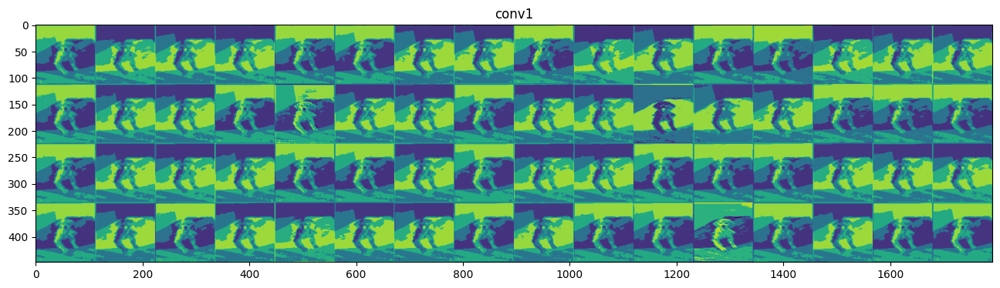

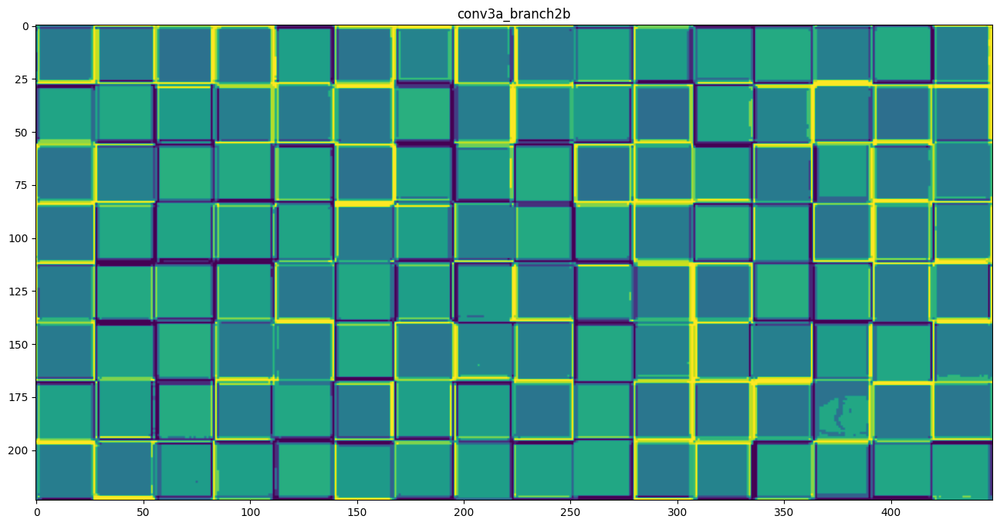

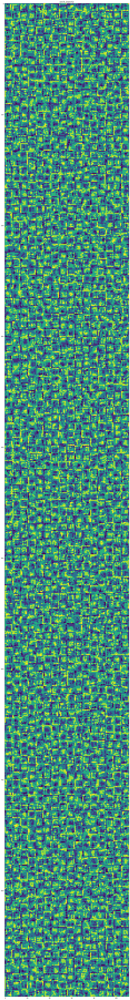

In [ ]:
# These are the names of the layers, so can have them as part of our plot
layer_names = []
# layer_names = layers_to_visualize
# for layer in model.layers[:50]:
#     layer_names.append(layer.name)
for layer in layers_to_visualize:
    print(layer.name)
    layer_names.append(layer.name)

images_per_row = 16

# Now let's display our feature maps
for layer_name, layer_activation in zip(layer_names, activations):
    # This is the number of features in the feature map
    n_features = layer_activation.shape[-1]

    # The feature map has shape (1, size, size, n_features)
    size = layer_activation.shape[1]

    # We will tile the activation channels in this matrix
    n_cols = n_features // images_per_row
    display_grid = np.zeros((size * n_cols, images_per_row * size))

    # We'll tile each filter into this big horizontal grid
    for col in range(n_cols):
        for row in range(images_per_row):
            channel_image = layer_activation[0,
                                             :, :,
                                             col * images_per_row + row]
            # Post-process the feature to make it visually palatable
            channel_image -= channel_image.mean()
            channel_image /= channel_image.std()
            channel_image *= 64
            channel_image += 128
            channel_image = np.clip(channel_image, 0, 255).astype('uint8')
            display_grid[col * size : (col + 1) * size,
                         row * size : (row + 1) * size] = channel_image

    # Display the grid
    scale = 1. / size
    plt.figure(figsize=(scale * display_grid.shape[1],
                        scale * display_grid.shape[0]))
    plt.title(layer_name)
    plt.grid(False)
    plt.imshow(display_grid, aspect='auto', cmap='viridis')

plt.show()

### PS1.A - Visualizing convnet filters

#### Chosen blocks/ layers

In [ ]:
model = load_model('model_resnet50_aug4.h5')

In [ ]:
layers_to_visualize = [model.get_layer('conv1_conv'),
                       model.get_layer('conv3_block2_2_conv'),
                       model.get_layer('conv5_block3_3_conv')]

for layer in layers_to_visualize:
    print(layer.name)


conv1_conv
conv3_block2_2_conv
conv5_block3_3_conv


In [ ]:
def deprocess_image(x):
    # normalize tensor: center on 0., ensure std is 0.1
    x -= x.mean()
    x /= (x.std() + 1e-5)
    x *= 0.1

    # clip to [0, 1]
    x += 0.5
    x = np.clip(x, 0, 1)

    # convert to RGB array
    x *= 255
    x = np.clip(x, 0, 255).astype('uint8')
    return x

In [ ]:
# Disable eager execution
tf.compat.v1.disable_eager_execution()

In [ ]:
# Modify your deprocess_image function as follows
def deprocess_image(x):
    x = x - x.mean()
    x = x / (x.std() + 1e-5)
    x = x * 0.1 + 0.5
    x = np.clip(x, 0, 1)
    x = x * 255
    x = np.clip(x, 0, 255).astype('uint8')
    return x

In [ ]:
def generate_pattern(layer_name, filter_index, size=224):

    # Load ResNet50 without top layers
    # model1 = ResNet50(weights=None, include_top=False)

    layer = model.get_layer(layer_name)
    input_img = model.input

    loss = K.mean(layer.output[:, :, :, filter_index])
    grads = K.gradients(loss, input_img)[0]
    grads /= (K.sqrt(K.mean(K.square(grads))) + 1e-5)

    iterate = K.function([input_img], [loss, grads])

    input_img_data = np.random.random((1, size, size, 3)) * 20 + 128.

    step = 1.
    for i in range(40):
        loss_value, grads_value = iterate([input_img_data])
        input_img_data += grads_value * step

    img = input_img_data[0]
    return deprocess_image(img)

2023-10-25 22:11:58.001917: W tensorflow/c/c_api.cc:305] Operation '{name:'conv5_block2_1_conv_6/kernel/Assign' id:32615 op device:{requested: '', assigned: ''} def:{{{node conv5_block2_1_conv_6/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](conv5_block2_1_conv_6/kernel, conv5_block2_1_conv_6/kernel/Initializer/stateless_random_uniform)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


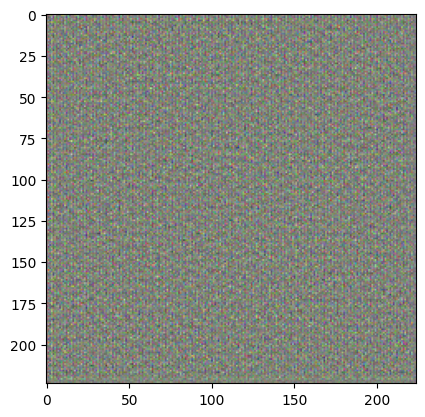

In [ ]:
# Now you can use generate_pattern function
layer_name = 'conv2_block1_1_conv'
filter_index = 0

pattern = generate_pattern(layer_name, filter_index)
plt.imshow(pattern)
plt.show()


#### First and Middle Conv Blocks

Scroll for both the images

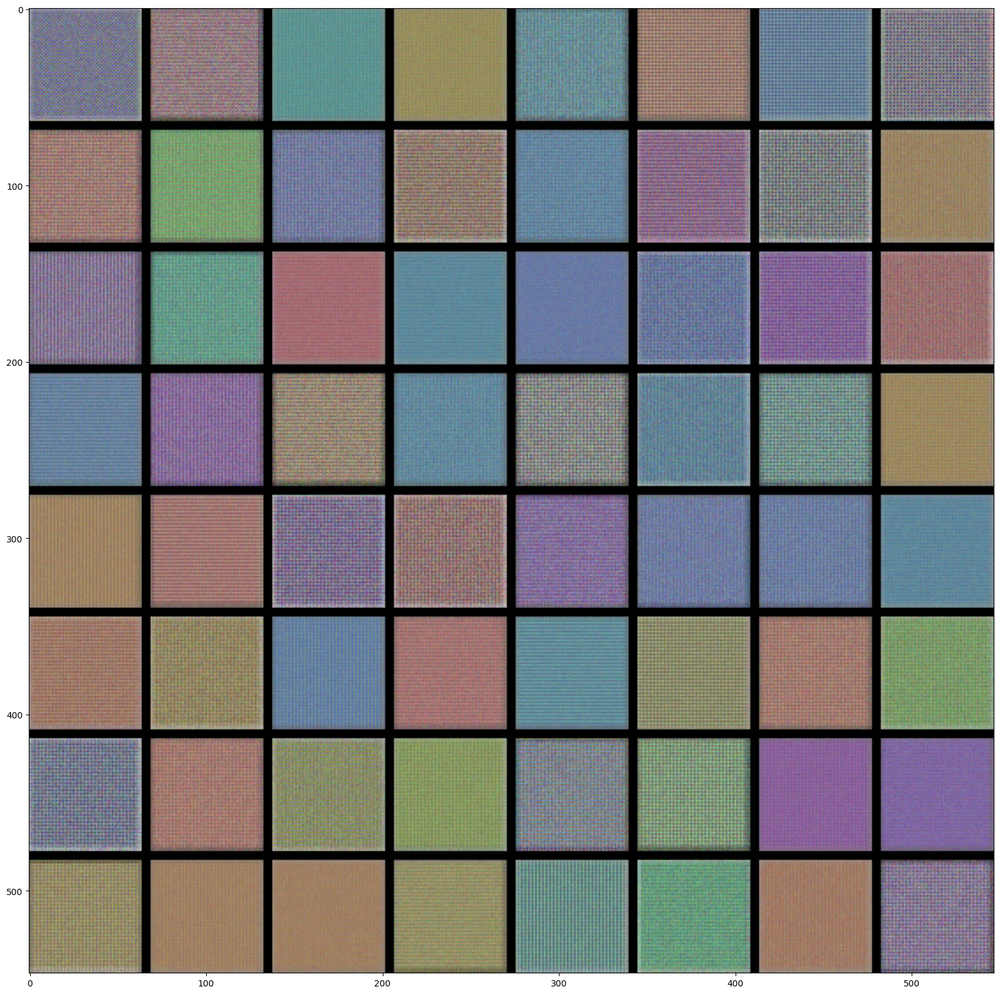

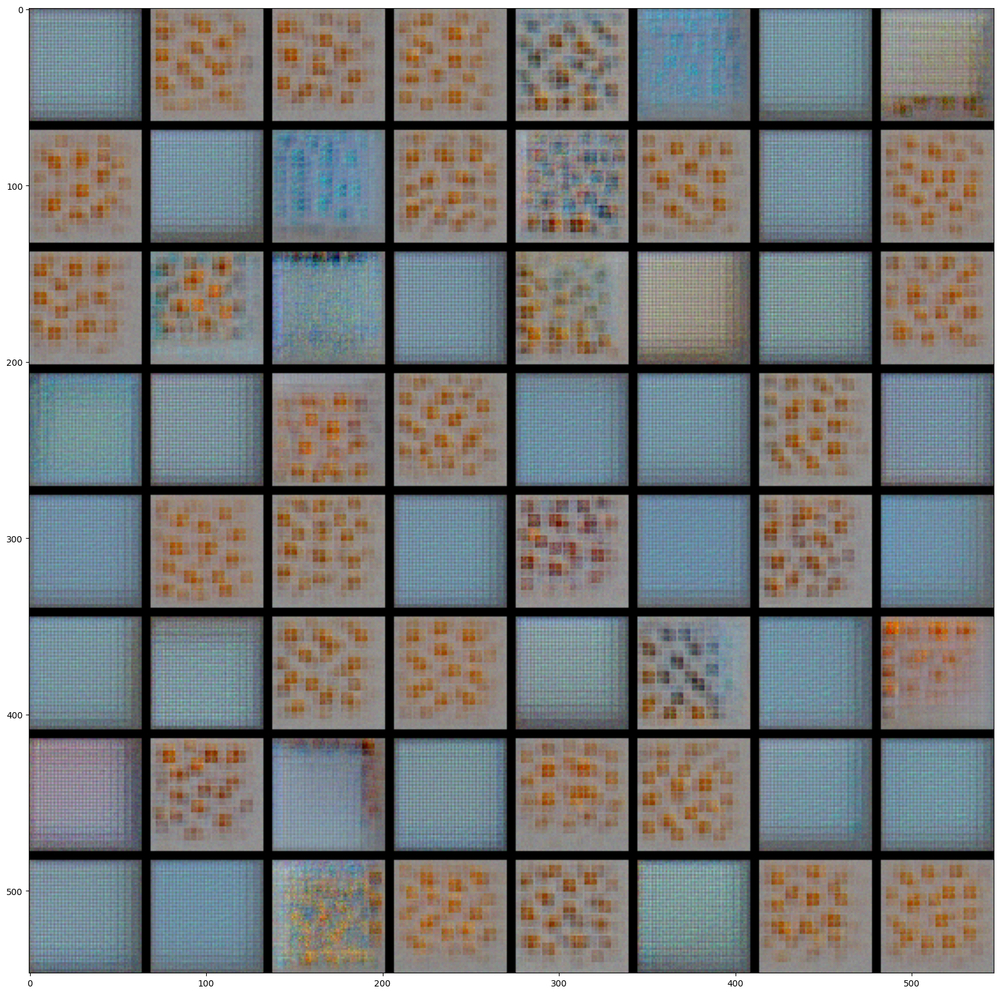

: 

In [ ]:
for layer_name in ['conv1_conv', 'conv3_block2_2_conv', 'conv5_block3_3_conv']:
    size = 64
    margin = 5

    # This a empty (black) image where we will store our results.
    results = np.zeros((8 * size + 7 * margin, 8 * size + 7 * margin, 3))

    for i in range(8):  # iterate over the rows of our results grid
        for j in range(8):  # iterate over the columns of our results grid
            # Generate the pattern for filter `i + (j * 8)` in `layer_name`
            filter_img = generate_pattern(layer_name, i + (j * 8), size=size)

            # Put the result in the square `(i, j)` of the results grid
            horizontal_start = i * size + i * margin
            horizontal_end = horizontal_start + size
            vertical_start = j * size + j * margin
            vertical_end = vertical_start + size
            results[horizontal_start: horizontal_end, vertical_start: vertical_end, :] = filter_img

    # Display the results grid
    plt.figure(figsize=(20, 20))
    plt.imshow((results * 255).astype(np.uint8))
    plt.show()

In [ ]:
model = load_model('model_resnet50_aug4.h5')
model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 conv1_pad (ZeroPadding2D)   (None, 230, 230, 3)          0         ['input_1[0][0]']             
                                                                                                  
 conv1_conv (Conv2D)         (None, 112, 112, 64)         9472      ['conv1_pad[0][0]']           
                                                                                                  
 conv1_bn (BatchNormalizati  (None, 112, 112, 64)         256       ['conv1_conv[0][0]']          
 on)                                                                                          

#### Last Conv Block
Plotted the last layer separately to "avoid kernel crash"

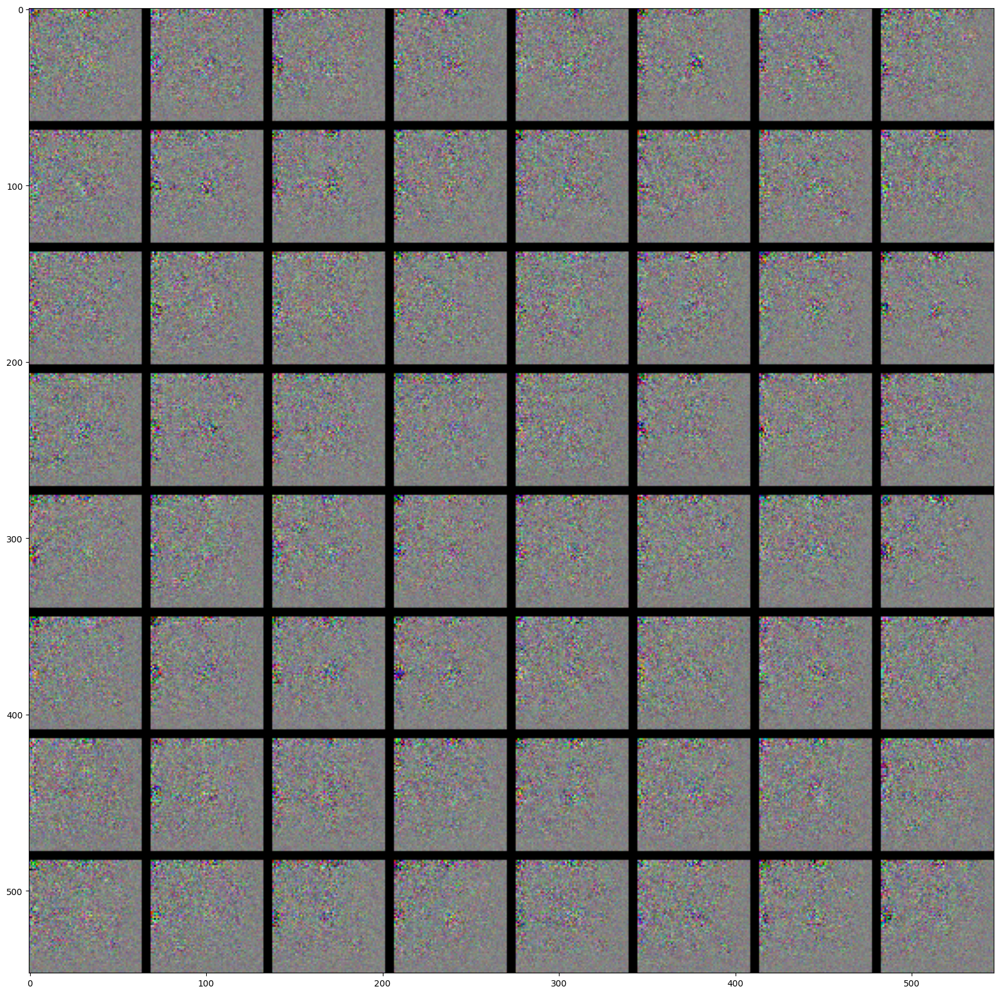

In [ ]:
for layer_name in ['conv5_block3_3_conv']:
    size = 64
    margin = 5

    # This a empty (black) image where we will store our results.
    results = np.zeros((8 * size + 7 * margin, 8 * size + 7 * margin, 3))

    for i in range(8):  # iterate over the rows of our results grid
        for j in range(8):  # iterate over the columns of our results grid
            # Generate the pattern for filter `i + (j * 8)` in `layer_name`
            filter_img = generate_pattern(layer_name, i + (j * 8), size=size)

            # Put the result in the square `(i, j)` of the results grid
            horizontal_start = i * size + i * margin
            horizontal_end = horizontal_start + size
            vertical_start = j * size + j * margin
            vertical_end = vertical_start + size
            results[horizontal_start: horizontal_end, vertical_start: vertical_end, :] = filter_img

    # Display the results grid
    plt.figure(figsize=(20, 20))
    plt.imshow((results * 255).astype(np.uint8))
    plt.show()

### PS1A. Visualizing heatmaps of class activation

In [ ]:
model = load_model('model_resnet50_aug4.h5')

2023-10-25 23:21:25.936815: W tensorflow/c/c_api.cc:305] Operation '{name:'conv3_block4_2_bn_1/beta/Assign' id:9217 op device:{requested: '', assigned: ''} def:{{{node conv3_block4_2_bn_1/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](conv3_block4_2_bn_1/beta, conv3_block4_2_bn_1/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


In [ ]:
import numpy as np

# The local path to our target image
#img_path = 'creative_commons_elephant.jpg'
img_path = 'refs/dog_1.jpg'

im_size = 224

# `img` is a PIL image of size 224x224
img = tf.keras.utils.load_img(img_path, target_size=(im_size, im_size))

# `x` is a float32 Numpy array of shape (224, 224, 3)
img_tensor = tf.keras.utils.img_to_array(img)

# We add a dimension to transform our array into a "batch"
# of size (1, 224, 224, 3)
img_tensor = np.expand_dims(img_tensor, axis=0)

img_tensor /= 255.

# # Its shape is (1, 224, 224, 3)
print(img_tensor.shape)

(1, 224, 224, 3)


In [ ]:
preds = model.predict(img_tensor)
def custom_decode_predictions(predictions, top=5, class_names=None):
    if class_names is None:
        class_names = [str(i) for i in range(predictions.shape[-1])]

    results = []
    for pred in predictions:
        top_indices = pred.argsort()[-top:][::-1]
        decoded_preds = [(class_names[i], pred[i]) for i in top_indices]
        results.append(decoded_preds)

    return results

classes = ['airplane', 'automobile', 'bird', 'cat', 'dog', 'deer', 'frog', 'horse', 'truck']

print('Predicted:', custom_decode_predictions(preds, top=5, class_names=classes))


/Users/banani/Library/Python/3.9/lib/python/site-packages/keras/src/engine/training_v1.py:2359: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates=self.state_updates,
2023-10-25 23:21:32.224473: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_1/Softmax' id:11531 op device:{requested: '', assigned: ''} def:{{{node dense_1/Softmax}} = Softmax[T=DT_FLOAT, _has_manual_control_dependencies=true](dense_1/BiasAdd)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-10-25 23:21:32.709967: W tensorflow/c/c_api.cc:305] Operation '{name:'total_1/Assign' id:12826 op device:{requested: '', assigned: ''} def:{{{node total_1/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, valid

Predicted: [[('dog', 0.16175188), ('frog', 0.15776682), ('horse', 0.15381174), ('deer', 0.12696117), ('cat', 0.10170399)]]


#### Chosen Layers or blocks

In [ ]:
layers_to_visualize = [model.get_layer('conv1_relu'),
                       model.get_layer('conv3_block2_2_relu'),
                       model.get_layer('conv5_block3_2_relu')]

for layer in layers_to_visualize:
    print(layer.name)

conv1_relu
conv3_block2_2_relu
conv5_block3_2_relu


In [ ]:
model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 conv1_pad (ZeroPadding2D)   (None, 230, 230, 3)          0         ['input_1[0][0]']             
                                                                                                  
 conv1_conv (Conv2D)         (None, 112, 112, 64)         9472      ['conv1_pad[0][0]']           
                                                                                                  
 conv1_bn (BatchNormalizati  (None, 112, 112, 64)         256       ['conv1_conv[0][0]']          
 on)                                                                                          

In [ ]:
import cv2

def overlay_heatmap(heatmap, img_path, alpha=0.4):
    img = cv2.imread(img_path)

    hmap = heatmap

    # Resize the heatmap to the size of the original image
    heatmap = cv2.resize(heatmap, (img.shape[1], img.shape[0]))

    # Normalize the heatmap
    heatmap = (heatmap - np.min(heatmap)) / (np.max(heatmap) - np.min(heatmap))

    # Apply a colormap to the heatmap
    heatmap = cv2.applyColorMap(np.uint8(255 * heatmap), cv2.COLORMAP_JET)

    # Superimpose the heatmap on the original image
    superimposed_img = heatmap * alpha + img


    fig, axes = plt.subplots(1, 3, figsize=(12, 8))


    # Display the heatmap in the second subplot
    axes[0].imshow(hmap)
    axes[0].set_title('Heatmap')
    axes[0].axis('off')

    # Display the heatmap in the second subplot
    axes[1].imshow(heatmap, cmap='jet')
    axes[1].set_title('Heatmap Normalized')
    axes[1].axis('off')


    # Display the superimposed image in the first subplot
    axes[2].imshow(cv2.cvtColor(np.uint8(superimposed_img), cv2.COLOR_BGR2RGB))
    axes[2].set_title('Superimposed Image')
    axes[2].axis('off')


    plt.show()


    # plt.imshow(cv2.cvtColor(np.uint8(superimposed_img), cv2.COLOR_BGR2RGB))
    # plt.axis('off')
    # plt.show()

#### First Layer Heatmap

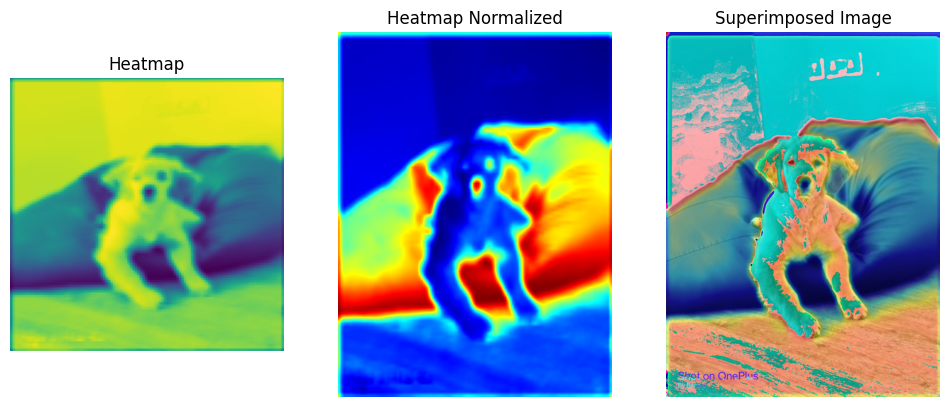

In [ ]:
# This is the "dog" entry in the prediction vector
dog_output = model.output[:, 4]

# The is the output feature map of the `conv3_block2_2_relu` layer,
# the first convolutional layer in ResNet50
first_conv_layer = model.get_layer('conv1_relu')

# This is the gradient of the "dog" class with regard to
# the output feature map of `conv5_block3_3_conv`
grads = K.gradients(dog_output, first_conv_layer.output)[0]

# This is a vector of shape (512,), where each entry
# is the mean intensity of the gradient over a specific feature map channel
pooled_grads = K.mean(grads, axis=(0, 1, 2))

# This function allows us to access the values of the quantities we just defined:
# `pooled_grads` and the output feature map of `block5_conv3`,
# given a sample image
iterate = K.function([model.input], [pooled_grads, first_conv_layer.output[0]])

# These are the values of these two quantities, as Numpy arrays,
# given our sample image of two elephants
pooled_grads_value, conv_layer_output_value = iterate([img_tensor])

# We multiply each channel in the feature map array
# by "how important this channel is" with regard to the elephant class
for i in range(64):
    conv_layer_output_value[:, :, i] *= pooled_grads_value[i]

# The channel-wise mean of the resulting feature map
# is our heatmap of class activation
heatmap_first = np.mean(conv_layer_output_value, axis=-1)

overlay_heatmap(heatmap_first, img_path)

#### Middle Layer Heatmap

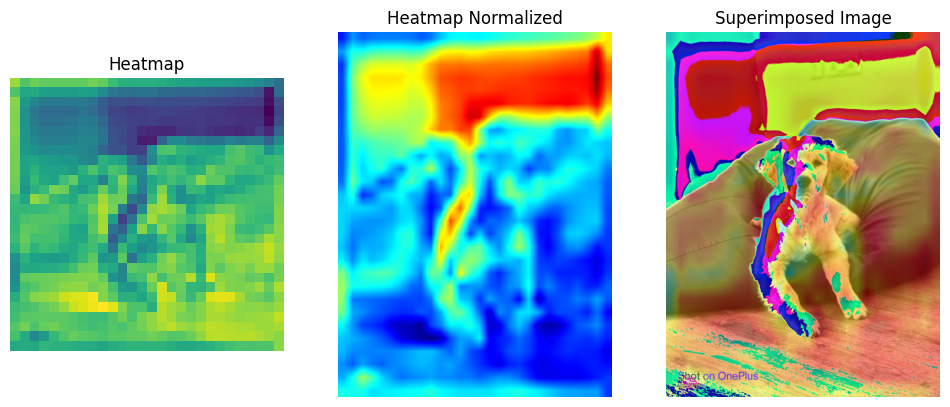

In [ ]:
# This is the "dog" entry in the prediction vector
dog_output = model.output[:, 4]

# The is the output feature map of the `conv3_block2_2_relu` layer,
# the middle convolutional layer in ResNet50
middle_conv_layer = model.get_layer('conv3_block2_2_relu')

# This is the gradient of the "dog" class with regard to
# the output feature map of `conv5_block3_3_conv`
grads = K.gradients(dog_output, middle_conv_layer.output)[0]

# This is a vector of shape (512,), where each entry
# is the mean intensity of the gradient over a specific feature map channel
pooled_grads = K.mean(grads, axis=(0, 1, 2))

# This function allows us to access the values of the quantities we just defined:
# `pooled_grads` and the output feature map of `block5_conv3`,
# given a sample image
iterate = K.function([model.input], [pooled_grads, middle_conv_layer.output[0]])

# These are the values of these two quantities, as Numpy arrays,
# given our sample image of two elephants
pooled_grads_value, conv_layer_output_value = iterate([img_tensor])

# We multiply each channel in the feature map array
# by "how important this channel is" with regard to the elephant class
for i in range(128):
    conv_layer_output_value[:, :, i] *= pooled_grads_value[i]

# The channel-wise mean of the resulting feature map
# is our heatmap of class activation
heatmap_middle = np.mean(conv_layer_output_value, axis=-1)

overlay_heatmap(heatmap_middle, img_path)

#### Last layer heatmap

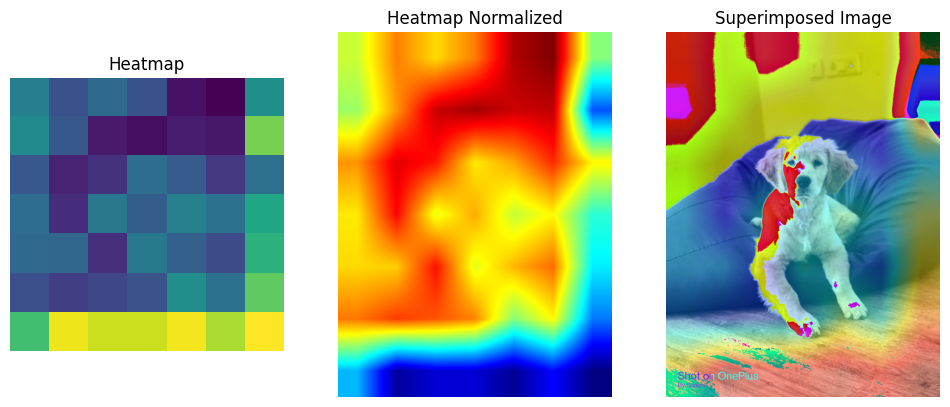

In [ ]:
# This is the "dog" entry in the prediction vector
dog_output = model.output[:, 4]

# The is the output feature map of the `conv5_block3_3_conv` layer,
# the last convolutional layer in ResNet50
last_conv_layer = model.get_layer('conv5_block3_3_conv')

# This is the gradient of the "dog" class with regard to
# the output feature map of `conv5_block3_3_conv`
grads = K.gradients(dog_output, last_conv_layer.output)[0]

# This is a vector of shape (512,), where each entry
# is the mean intensity of the gradient over a specific feature map channel
pooled_grads = K.mean(grads, axis=(0, 1, 2))

# This function allows us to access the values of the quantities we just defined:
# `pooled_grads` and the output feature map of `block5_conv3`,
# given a sample image
iterate = K.function([model.input], [pooled_grads, last_conv_layer.output[0]])

# These are the values of these two quantities, as Numpy arrays,
# given our sample image of two elephants
pooled_grads_value, conv_layer_output_value = iterate([img_tensor])

# We multiply each channel in the feature map array
# by "how important this channel is" with regard to the elephant class
for i in range(512):
    conv_layer_output_value[:, :, i] *= pooled_grads_value[i]

# The channel-wise mean of the resulting feature map
# is our heatmap of class activation
heatmap_last = np.mean(conv_layer_output_value, axis=-1)

overlay_heatmap(heatmap_last, img_path)

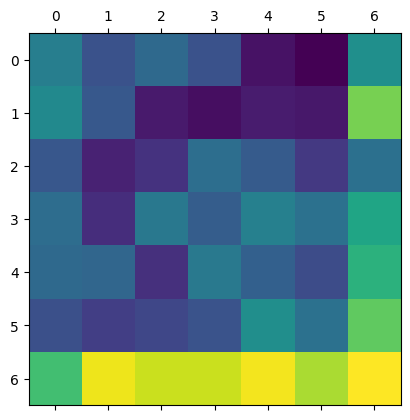

In [ ]:
# # print(heatmap)
# heatmap = np.maximum(heatmap, 0)
# heatmap /= np.max(heatmap)
# plt.matshow(heatmap)
# plt.show()

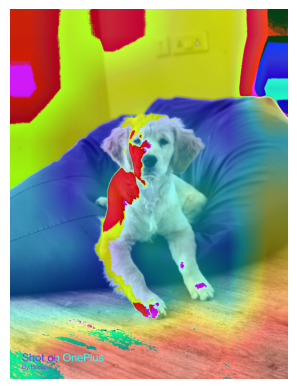

In [ ]:
overlay_heatmap(heatmap, img_path)

In [ ]:
# # print(heatmap)
# heatmap = np.maximum(heatmap, 0)
# heatmap /= np.max(heatmap)
# plt.matshow(heatmap)
# plt.show()

In [ ]:
# overlay_heatmap(heatmap, img_path)

## PS 1.B - 20 points

In [this notebook](https://pantelis.github.io/artificial-intelligence/aiml-common/lectures/transfer-learning/transfer_learning_tutorial.html) we showcase _transfer learning_ using a pre-trained CNN model.

Perform the fine-tunning and feature extraction methods of transfer learning using the same model as in PS-1A, for the class `ship`.

Repeat the visualization of PS-1.A before and after  transfer learning and write a conclusive summary as to the relative value of the two methods.

In [ ]:
# Insert your code here

#Load base_model from PS 1.A
# base_model = load_model('model_my_custom_resnet50_aug1.h5')
# base_model = tf.keras.models.load_model('model_my_custom_resnet50_1.h5')
base_model = load_model('model_resnet50_aug4.h5')
base_model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 conv1_pad (ZeroPadding2D)   (None, 230, 230, 3)          0         ['input_1[0][0]']             
                                                                                                  
 conv1_conv (Conv2D)         (None, 112, 112, 64)         9472      ['conv1_pad[0][0]']           
                                                                                                  
 conv1_bn (BatchNormalizati  (None, 112, 112, 64)         256       ['conv1_conv[0][0]']          
 on)                                                                                          

Here model 2 will get defined using model2b = Model(input = base-model.input, output = base-model.outputs)
 but update base-model.outputs' s last layer for sigmoid

### Freeze the base layer

In [ ]:
for layer in base_model.layers:
    layer.trainable = False

base_model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 conv1_pad (ZeroPadding2D)   (None, 230, 230, 3)          0         ['input_1[0][0]']             
                                                                                                  
 conv1_conv (Conv2D)         (None, 112, 112, 64)         9472      ['conv1_pad[0][0]']           
                                                                                                  
 conv1_bn (BatchNormalizati  (None, 112, 112, 64)         256       ['conv1_conv[0][0]']          
 on)                                                                                          

#### Feature Extraction

In [ ]:
# Add a new Dense layer with sigmoid activation for binary classification

num_classes = 1  # For binary classification
output_layer = Dense(num_classes, activation='sigmoid', name='fc9_predictions')(base_model.layers[-2].output)

model_2b = Model(inputs=base_model.input, outputs=output_layer)

model_2b.summary()


Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 conv1_pad (ZeroPadding2D)   (None, 230, 230, 3)          0         ['input_1[0][0]']             
                                                                                                  
 conv1_conv (Conv2D)         (None, 112, 112, 64)         9472      ['conv1_pad[0][0]']           
                                                                                                  
 conv1_bn (BatchNormalizati  (None, 112, 112, 64)         256       ['conv1_conv[0][0]']          
 on)                                                                                          

 conv2_block3_add (Add)      (None, 56, 56, 256)          0         ['conv2_block2_out[0][0]',    
                                                                     'conv2_block3_3_bn[0][0]']   
                                                                                                  
 conv2_block3_out (Activati  (None, 56, 56, 256)          0         ['conv2_block3_add[0][0]']    
 on)                                                                                              
                                                                                                  
 conv3_block1_1_conv (Conv2  (None, 28, 28, 128)          32896     ['conv2_block3_out[0][0]']    
 D)                                                                                               
                                                                                                  
 conv3_block1_1_bn (BatchNo  (None, 28, 28, 128)          512       ['conv3_block1_1_conv[0][0]'] 
 rmalizati

#### Fine Tuning

In [ ]:
# Set hyperparameters
learning_rate = 0.001
beta1 = 0.9
beta2 = 0.999
epsilon = 1e-8
num_iterations = 1000
# optimizer = Adam(learning_rate=learning_rate, beta_1=beta1, beta_2=beta2, epsilon=1e-8)
optimizer = SGD(learning_rate=learning_rate, momentum=0.9, nesterov=True)

In [ ]:
# Create the final model
transfer_model = Model(inputs=model_2b.input, outputs=model_2b.outputs)

# Compile the model with an appropriate optimizer and loss function
# transfer_model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

transfer_model.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['accuracy'])

transfer_model.summary()


Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 conv1_pad (ZeroPadding2D)   (None, 230, 230, 3)          0         ['input_1[0][0]']             
                                                                                                  
 conv1_conv (Conv2D)         (None, 112, 112, 64)         9472      ['conv1_pad[0][0]']           
                                                                                                  
 conv1_bn (BatchNormalizati  (None, 112, 112, 64)         256       ['conv1_conv[0][0]']          
 on)                                                                                        

 conv4_block4_2_relu (Activ  (None, 14, 14, 256)          0         ['conv4_block4_2_bn[0][0]']   
 ation)                                                                                           
                                                                                                  
 conv4_block4_3_conv (Conv2  (None, 14, 14, 1024)         263168    ['conv4_block4_2_relu[0][0]'] 
 D)                                                                                               
                                                                                                  
 conv4_block4_3_bn (BatchNo  (None, 14, 14, 1024)         4096      ['conv4_block4_3_conv[0][0]'] 
 rmalization)                                                                                     
                                                                                                  
 conv4_block4_add (Add)      (None, 14, 14, 1024)         0         ['conv4_block3_out[0][0]',    
          

### Data pre-processing for 2B

In [ ]:
(x_train_new, y_train_new), (x_test_new, y_test_new) = cifar10.load_data()

classes = len(np.unique(y_train_new))
classes

10

In [ ]:
print(x_train_new.shape, y_train_new.shape, x_test_new.shape, y_test_new.shape)

(50000, 32, 32, 3) (50000, 1) (10000, 32, 32, 3) (10000, 1)


In [ ]:
index = np.where(y_train_new == 8)
# Filter the dataset for 9 out of 10 classes (exclude "ship index 8" class)
ship_class = 8  # Adjust this class to exclude "ship"
x_train_new = x_train_new / 255.0
# y_train_new = y_train_new[y_train_new == ship_class].astype(int)
# Create binary labels (0 for negative, 1 for positive)
y_train_new_norm = np.where(y_train_new == ship_class, 1, 0)
x_test_new = x_test_new / 255.0
y_test_new_norm = np.where(y_test_new == ship_class, 1, 0)
# y_test_new = y_test_new[y_test_new == ship_class].astype(int)


# number of classes K=9
k = 1

In [ ]:
print(x_train_new.shape, y_train_new.shape, x_test_new.shape, y_test_new.shape)

(50000, 32, 32, 3) (50000, 1) (10000, 32, 32, 3) (10000, 1)


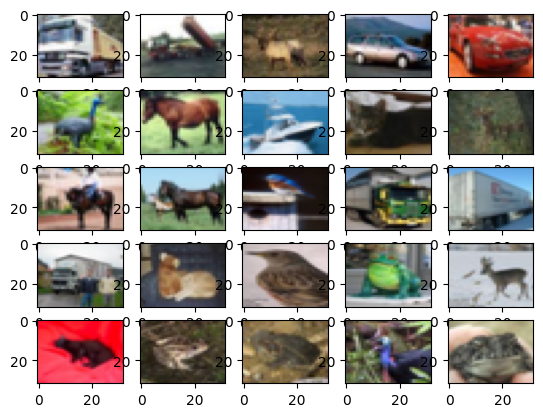

In [ ]:
# visualize data by plotting images
fig, ax = plt.subplots(5, 5)
k = 1

for i in range(5):
    for j in range(5):
        ax[i][j].imshow(x_train_new[k], aspect='auto')
        k += 1

plt.show()

In [ ]:
# A ResNet-50 model expects 224 × 224–pixel images
im_size = 224

x_train_new_resize = Resizing(height=im_size, width=im_size, crop_to_aspect_ratio=True)(x_train_new)
x_test_new_resize = Resizing(height=im_size, width=im_size, crop_to_aspect_ratio=True)(x_test_new)

In [ ]:
print(x_train_new_resize.shape, y_train_new_norm.shape, x_test_new_resize.shape, y_test_new_norm.shape)

(50000, 224, 224, 3) (50000, 1) (10000, 224, 224, 3) (10000, 1)


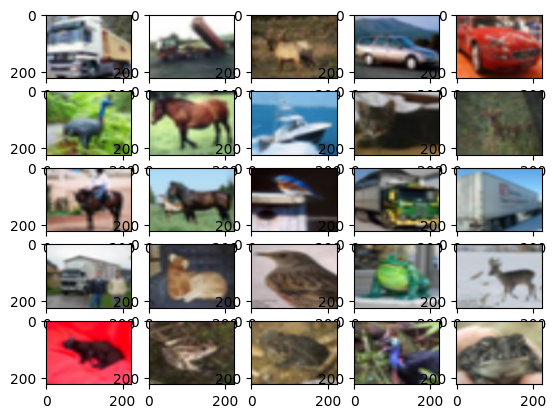

In [ ]:
# visualize data by plotting images
fig, ax = plt.subplots(5, 5)
k = 1

for i in range(5):
    for j in range(5):
        ax[i][j].imshow(x_train_new_resize[k], aspect='auto')
        k += 1

plt.show()

In [ ]:
## Data augmentation
batch_size = 32
data_generator = tf.keras.preprocessing.image.ImageDataGenerator(
  width_shift_range=0.1,
  height_shift_range=0.1,
    horizontal_flip=True,)

train_generator_new = data_generator.flow(x_train_new_resize,
                                      y_train_new_norm,
                                      batch_size)
steps_per_epoch = x_train_new_resize.shape[0] // batch_size


In [ ]:
val_loss_callback = ValidationLoss()
lr_scheduler = CustomLRScheduler()


transfer_model.fit_generator(
    train_generator_new,  # Your training labels
    epochs=10,
    steps_per_epoch=10,
    validation_data=(x_test_new_resize, y_test_new_norm),
    callbacks=[val_loss_callback, lr_scheduler]
    # Other parameters like callbacks, verbose, etc.
)


# transfer_model.fit(
#     x=x_train_new_resize,  # Your training data
#     y=y_train_new_norm,  # Your training labels
#     batch_size=64,
#     epochs=10,
#     steps_per_epoch=10,
#     validation_data=(x_test_new_resize, y_test_new_norm),
#     callbacks=[val_loss_callback, lr_scheduler]
#     # Other parameters like callbacks, verbose, etc.
# )

transfer_model.save('transfer_resnet50_2b_aug1.h5')

Epoch 1: Learning Rate = 0.001
Epoch 1/10


/var/folders/xy/1x8f1vlx569_ch145p3563j80000gn/T/ipykernel_17264/2315718120.py:16: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  transfer_model.fit_generator(


10/10 [==============================] - 51s 5s/step - loss: 0.0952 - accuracy: 0.9831 - val_loss: 5.3289 - val_accuracy: 0.0000e+00
Epoch 2: Learning Rate = 0.0007071067811865475
Epoch 2/10
10/10 [==============================] - 48s 5s/step - loss: 3.3305e-05 - accuracy: 1.0000 - val_loss: 7.3087 - val_accuracy: 0.0000e+00
Epoch 3: Learning Rate = 0.0005773502691896258
Epoch 3/10
10/10 [==============================] - 50s 5s/step - loss: 2.7973e-06 - accuracy: 1.0000 - val_loss: 8.2863 - val_accuracy: 0.0000e+00
Epoch 4: Learning Rate = 0.0005
Epoch 4/10
10/10 [==============================] - 50s 5s/step - loss: 2.1394e-06 - accuracy: 1.0000 - val_loss: 8.8889 - val_accuracy: 0.0000e+00
Epoch 5: Learning Rate = 0.0004472135954999579
Epoch 5/10
10/10 [==============================] - 48s 5s/step - loss: 2.3662e-06 - accuracy: 1.0000 - val_loss: 9.2786 - val_accuracy: 0.0000e+00
Epoch 6: Learning Rate = 0.0004082482904638631
Epoch 6/10
10/10 [==============================] - 47s

/Users/banani/Library/Python/3.9/lib/python/site-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


### Pre process the test image

In [ ]:
layers_to_visualize = [transfer_model.get_layer('conv1_relu'),
                       transfer_model.get_layer('conv3_block2_2_relu'),
                       transfer_model.get_layer('conv5_block3_2_relu')]

for layer in layers_to_visualize:
    print(layer.name)

conv1_relu
conv3_block2_2_relu
conv5_block3_2_relu


(1, 224, 224, 3)


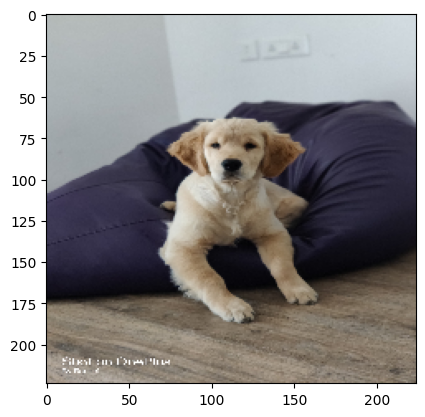

In [ ]:
# img_path = 'dogscats/subset/test/cats/cat.1700.jpg'
img_path='refs/dog_1.jpg'
# img_path='refs/dog.215.jpg'

im_size = 224

img = tf.keras.utils.load_img(img_path, target_size=(im_size, im_size))
img_tensor = tf.keras.utils.img_to_array(img)
img_tensor = np.expand_dims(img_tensor, axis=0)

img_tensor /= 255.

# Its shape is (1, 224, 224, 3)
print(img_tensor.shape)

plt.imshow(img_tensor[0])
plt.show()

### Image pre process to visualize

In [ ]:
# import tensorflow as tf
transfer_model = tf.keras.models.load_model('transfer_resnet50_2b_aug1.h5')
transfer_model.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 conv1_pad (ZeroPadding2D)   (None, 230, 230, 3)          0         ['input_1[0][0]']             
                                                                                                  
 conv1_conv (Conv2D)         (None, 112, 112, 64)         9472      ['conv1_pad[0][0]']           
                                                                                                  
 conv1_bn (BatchNormalizati  (None, 112, 112, 64)         256       ['conv1_conv[0][0]']          
 on)                                                                                        

32/32 [==============================] - 21s 637ms/step


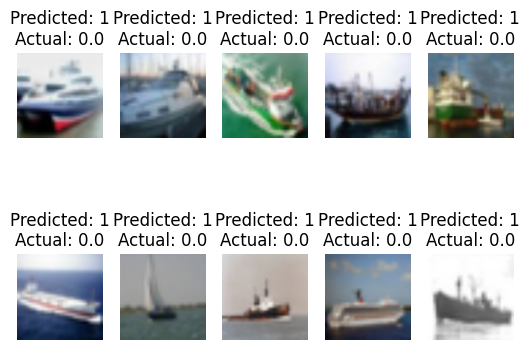

In [ ]:
# Visualize predictions on test data
predictions = transfer_model.predict(x_test_new_resize)
predicted_labels = (predictions > 0.5).astype(int)
sample_images = x_test_new_resize[:10]
sample_labels = y_test_new_norm[:10]

for i in range(10):
    plt.subplot(2, 5, i + 1)
    plt.imshow(sample_images[i])
    plt.title(f'Predicted: {predicted_labels[i][0]}\nActual: {sample_labels[i][0]}')
    plt.axis('off')

plt.show()

### PS1.B Visualize Activation

In [ ]:
# img_path = 'dogscats/subset/test/cats/cat.1700.jpg'
img_path='refs/dog_1.jpg'
# img_path='refs/dog.215.jpg'

# We preprocess the image into a 4D tensor
from keras.preprocessing import image
import numpy as np

im_size = 224

img = tf.keras.utils.load_img(img_path, target_size=(im_size, im_size))
img_tensor = tf.keras.utils.img_to_array(img)
img_tensor = np.expand_dims(img_tensor, axis=0)
# Remember that the model was trained on inputs
# that were preprocessed in the following way:
img_tensor /= 255.

# Its shape is (1, 150, 150, 3)
print(img_tensor.shape)

(1, 224, 224, 3)


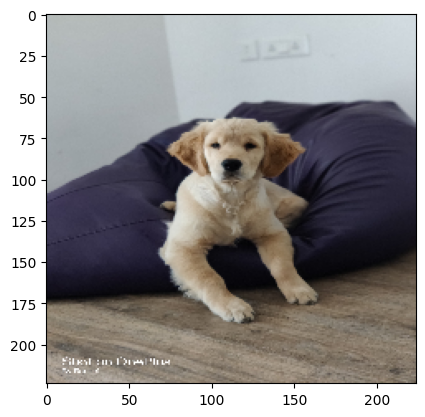

In [ ]:
plt.imshow(img_tensor[0])
plt.show()

#### Chosen layer

In [ ]:
layers_to_visualize = [transfer_model.get_layer('conv1_relu'),
                       transfer_model.get_layer('conv3_block2_2_relu'),
                       transfer_model.get_layer('conv5_block3_2_relu')]

for layer in layers_to_visualize:
    print(layer.name)

conv1_relu
conv3_block2_2_relu
conv5_block3_2_relu


In [ ]:
act_input1 = transfer_model.input
# Extracts the outputs of the top 50 layers:
# layer_outputs = [layer.output for layer in model.layers[1:51]]
layer_outputs1 = [layer.output for layer in layers_to_visualize]

# First block :  conv1
# Middle block:  conv2c_branch2b
# Last block:    conv5c_branch2c

# layer_outputs = [layer.output for layer in layers_to_visualize]
# Creates a model that will return these outputs, given the model input:
activation_model1 = Model(inputs=act_input1, outputs=layer_outputs1)
activation_model1.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 conv1_pad (ZeroPadding2D)   (None, 230, 230, 3)          0         ['input_1[0][0]']             
                                                                                                  
 conv1_conv (Conv2D)         (None, 112, 112, 64)         9472      ['conv1_pad[0][0]']           
                                                                                                  
 conv1_bn (BatchNormalizati  (None, 112, 112, 64)         256       ['conv1_conv[0][0]']          
 on)                                                                                        

#### First Block Activation

1/1 [==============================] - 0s 55ms/step
(1, 112, 112, 64)
(1, 112, 112, 64)
(1, 28, 28, 128)
(1, 7, 7, 512)


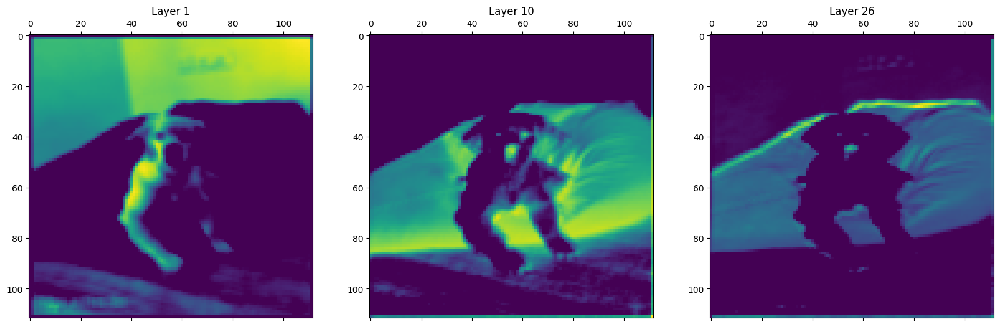

In [ ]:
activations = activation_model1.predict([img_tensor])

first_layer_activation = activations[0]
print(first_layer_activation.shape)

for activation in activations:
    print(activation.shape)

fig, axes = plt.subplots(1, 3,  figsize=(20, 8))

# Display the first activation
axes[0].matshow(first_layer_activation[0, :, :, 6], cmap='viridis')
axes[0].set_title('Layer 1')

# Display the second activation
axes[1].matshow(first_layer_activation[0, :, :, 10], cmap='viridis')
axes[1].set_title('Layer 10')

# Display the second activation
axes[2].matshow(first_layer_activation[0, :, :, 15], cmap='viridis')
axes[2].set_title('Layer 26')

# Show the subplots
plt.show()

This nose and eyes looks more bright green and is further clear or better to encode dog eyes and nose in the learnt model

At this point, let’s go and plot a complete visualization of all the activations in the network.

#### Middle Block Activation

1/1 [==============================] - 0s 62ms/step
(1, 28, 28, 128)
(1, 112, 112, 64)
(1, 28, 28, 128)
(1, 7, 7, 512)


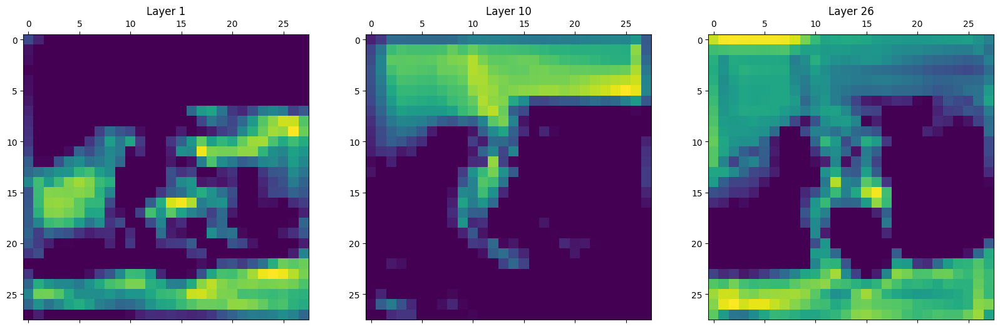

In [ ]:
activations = activation_model1.predict([img_tensor])

middle_layer_activation = activations[1]
print(middle_layer_activation.shape)

for activation in activations:
    print(activation.shape)

fig, axes = plt.subplots(1, 3,  figsize=(20, 8))

# Display the first activation
axes[0].matshow(middle_layer_activation[0, :, :, 6], cmap='viridis')
axes[0].set_title('Layer 1')

# Display the second activation
axes[1].matshow(middle_layer_activation[0, :, :, 10], cmap='viridis')
axes[1].set_title('Layer 10')

# Display the second activation
axes[2].matshow(middle_layer_activation[0, :, :, 15], cmap='viridis')
axes[2].set_title('Layer 26')

# Show the subplots
plt.show()

#### Last Block Activation

1/1 [==============================] - 0s 53ms/step
(1, 112, 112, 64)
(1, 112, 112, 64)
(1, 28, 28, 128)
(1, 7, 7, 512)


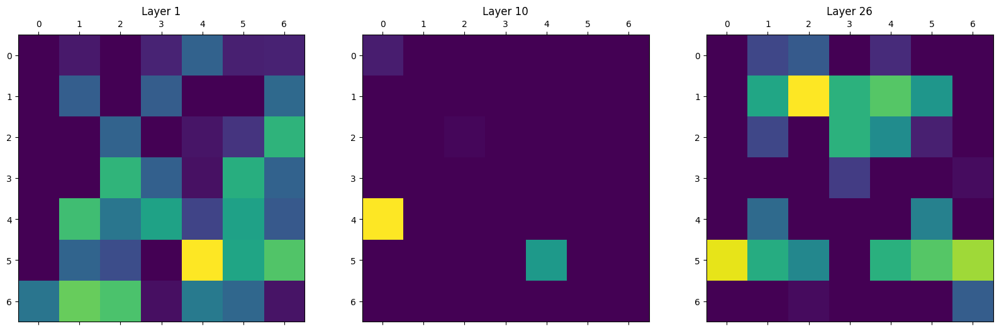

In [ ]:
activations = activation_model1.predict([img_tensor])

last_layer_activation = activations[2]
print(first_layer_activation.shape)

for activation in activations:
    print(activation.shape)

fig, axes = plt.subplots(1, 3,  figsize=(20, 8))

# Display the first activation
axes[0].matshow(last_layer_activation[0, :, :, 1], cmap='viridis')
axes[0].set_title('Layer 1')

# Display the second activation
axes[1].matshow(last_layer_activation[0, :, :, 11], cmap='viridis')
axes[1].set_title('Layer 10')

# Display the second activation
axes[2].matshow(last_layer_activation[0, :, :, 15], cmap='viridis')
axes[2].set_title('Layer 26')

# Show the subplots
plt.show()

#### All Block channels

conv1_relu
conv3_block2_2_relu
conv5_block3_2_relu


/var/folders/xy/1x8f1vlx569_ch145p3563j80000gn/T/ipykernel_17264/1518767542.py:37: RuntimeWarning: invalid value encountered in cast
  channel_image = np.clip(channel_image, 0, 255).astype('uint8')


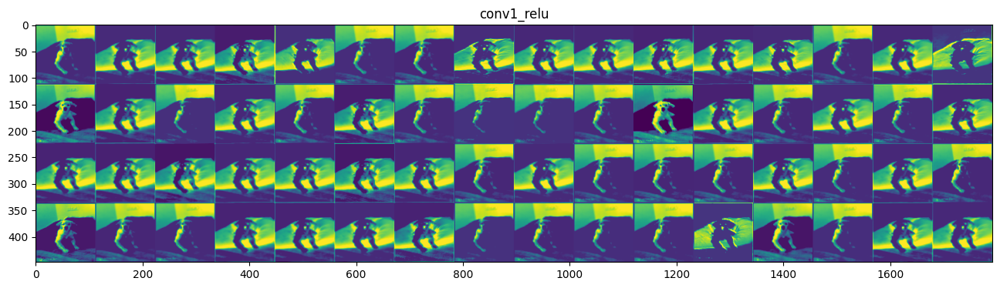

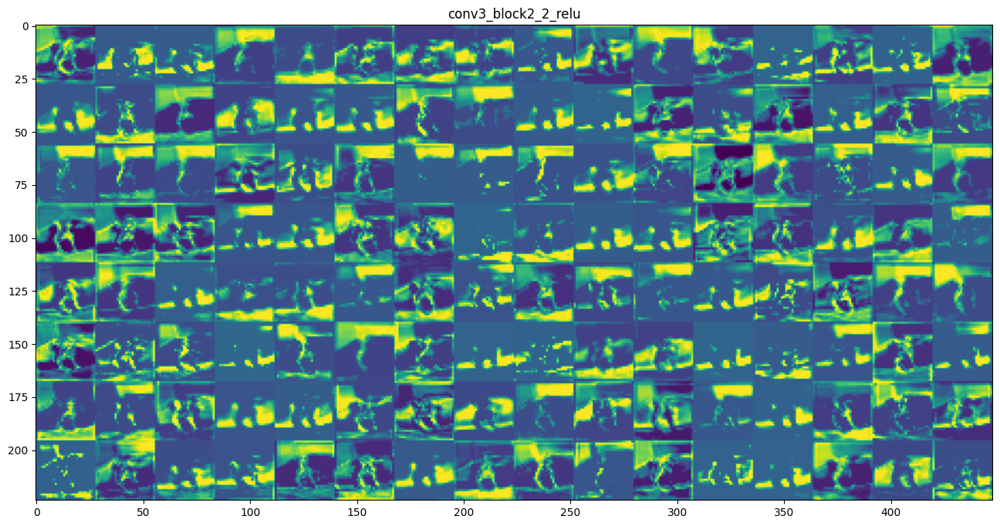

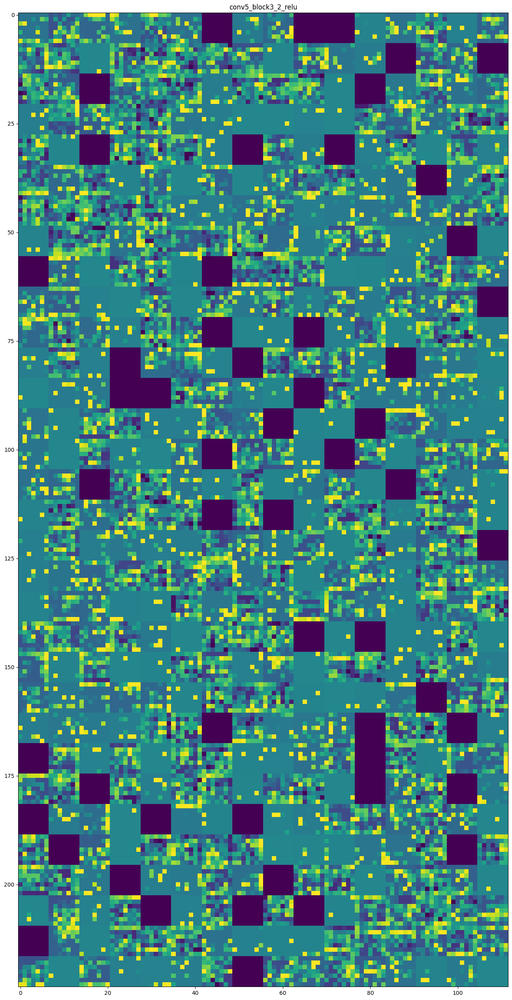

In [ ]:
# These are the names of the layers, so can have them as part of our plot
layer_names = []
# layer_names = layers_to_visualize
# for layer in model.layers[:50]:
#     layer_names.append(layer.name)
for layer in layers_to_visualize:
    print(layer.name)
    layer_names.append(layer.name)

# layer_names = layers_to_visualize

images_per_row = 16

# Now let's display our feature maps
for layer_name, layer_activation in zip(layer_names, activations):
    # This is the number of features in the feature map
    n_features = layer_activation.shape[-1]

    # The feature map has shape (1, size, size, n_features)
    size = layer_activation.shape[1]

    # We will tile the activation channels in this matrix
    n_cols = n_features // images_per_row
    display_grid = np.zeros((size * n_cols, images_per_row * size))

    # We'll tile each filter into this big horizontal grid
    for col in range(n_cols):
        for row in range(images_per_row):
            channel_image = layer_activation[0,
                                             :, :,
                                             col * images_per_row + row]
            # Post-process the feature to make it visually palatable
            channel_image -= channel_image.mean()
            channel_image /= channel_image.std()
            channel_image *= 64
            channel_image += 128
            channel_image = np.clip(channel_image, 0, 255).astype('uint8')
            display_grid[col * size : (col + 1) * size,
                         row * size : (row + 1) * size] = channel_image

    # Display the grid
    scale = 1. / size
    plt.figure(figsize=(scale * display_grid.shape[1],
                        scale * display_grid.shape[0]))
    plt.title(layer_name)
    plt.grid(False)
    plt.imshow(display_grid, aspect='auto', cmap='viridis')

plt.show()

Please scroll for all the plots

### PS1.B Visualize convnet Filter

In [ ]:
layers_to_visualize = [transfer_model.get_layer('conv1_conv'),
                       transfer_model.get_layer('conv3_block2_2_conv'),
                       transfer_model.get_layer('conv5_block3_3_conv')]

for layer in layers_to_visualize:
    print(layer.name)


conv1_conv
conv3_block2_2_conv
conv5_block3_3_conv


In [ ]:
def deprocess_image(x):
    # normalize tensor: center on 0., ensure std is 0.1
    x -= x.mean()
    x /= (x.std() + 1e-5)
    x *= 0.1

    # clip to [0, 1]
    x += 0.5
    x = np.clip(x, 0, 1)

    # convert to RGB array
    x *= 255
    x = np.clip(x, 0, 255).astype('uint8')
    return x

In [ ]:
# Disable eager execution
tf.compat.v1.disable_eager_execution()

In [ ]:
def generate_pattern_transfer(layer_name, filter_index, size=224):

    layer = transfer_model.get_layer(layer_name)
    input_img = transfer_model.input

    loss = K.mean(layer.output[:, :, :, filter_index])
    grads = K.gradients(loss, input_img)[0]
    grads /= (K.sqrt(K.mean(K.square(grads))) + 1e-5)

    iterate = K.function([input_img], [loss, grads])

    input_img_data = np.random.random((1, size, size, 3)) * 20 + 128.

    step = 1.
    for i in range(40):
        loss_value, grads_value = iterate([input_img_data])
        input_img_data += grads_value * step

    img = input_img_data[0]
    return deprocess_image(img)

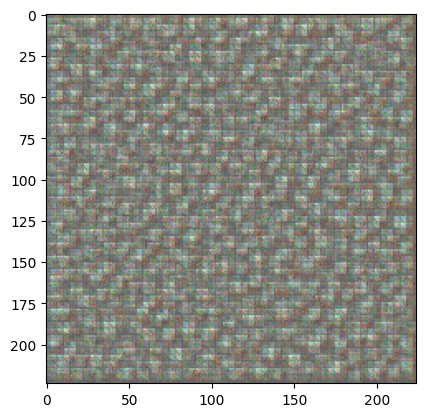

In [ ]:
# Now you can use generate_pattern function
layer_name = 'conv2_block1_1_conv'
filter_index = 0

pattern = generate_pattern_transfer(layer_name, filter_index)
plt.imshow(pattern)
plt.show()

#### First and Middle Block

Instructions for updating:
Colocations handled automatically by placer.


Instructions for updating:
Colocations handled automatically by placer.


2023-10-26 03:59:55.775561: I tensorflow/compiler/mlir/mlir_graph_optimization_pass.cc:382] MLIR V1 optimization pass is not enabled
2023-10-26 03:59:55.973099: W tensorflow/c/c_api.cc:305] Operation '{name:'conv5_block1_3_bn/moving_mean/Assign' id:3409 op device:{requested: '', assigned: ''} def:{{{node conv5_block1_3_bn/moving_mean/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](conv5_block1_3_bn/moving_mean, conv5_block1_3_bn/moving_mean/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


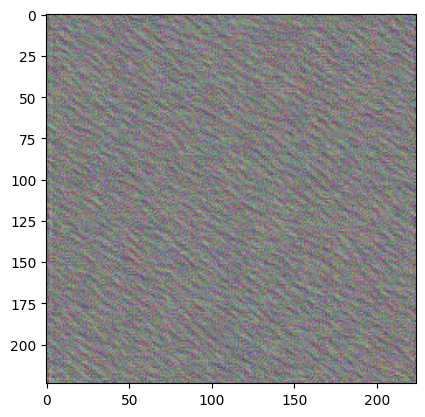

In [ ]:
# Now you can use generate_pattern function
layer_name = 'conv2_block1_1_conv'
filter_index = 0

pattern = generate_pattern(layer_name, filter_index)
plt.imshow(pattern)
plt.show()

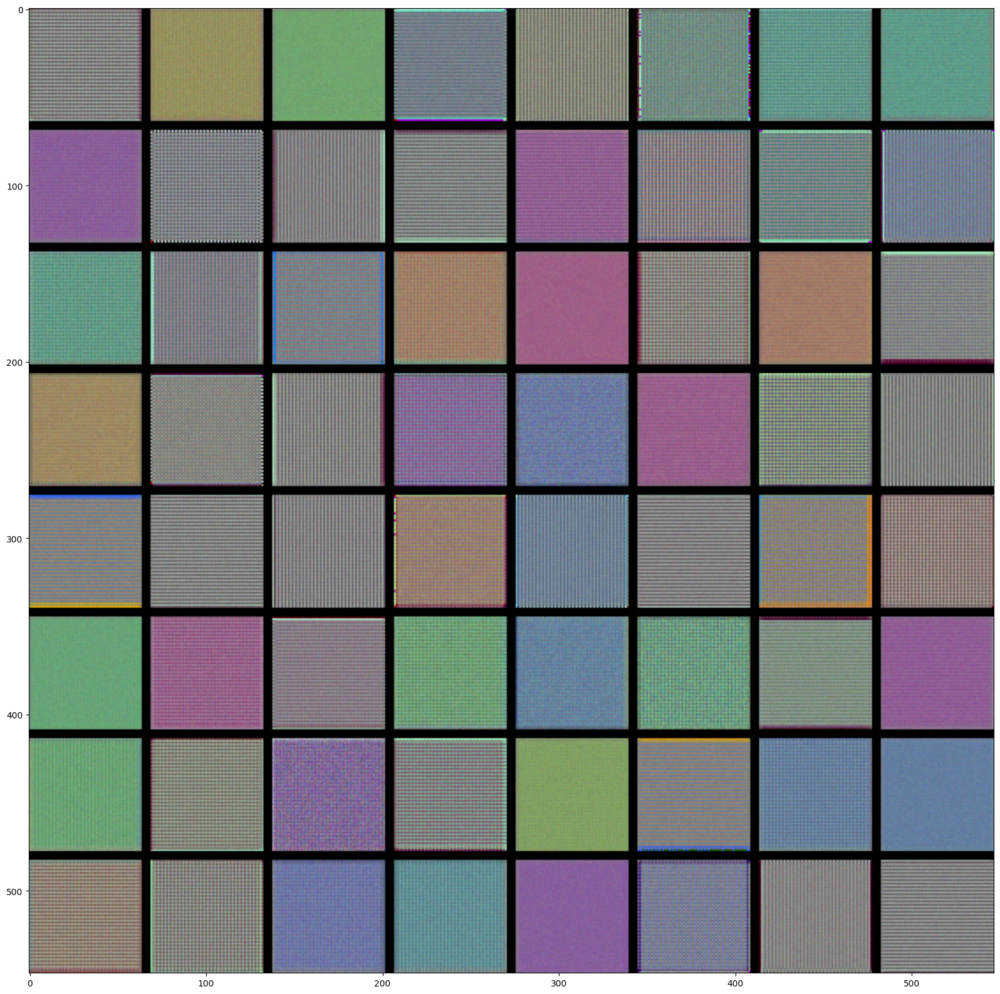

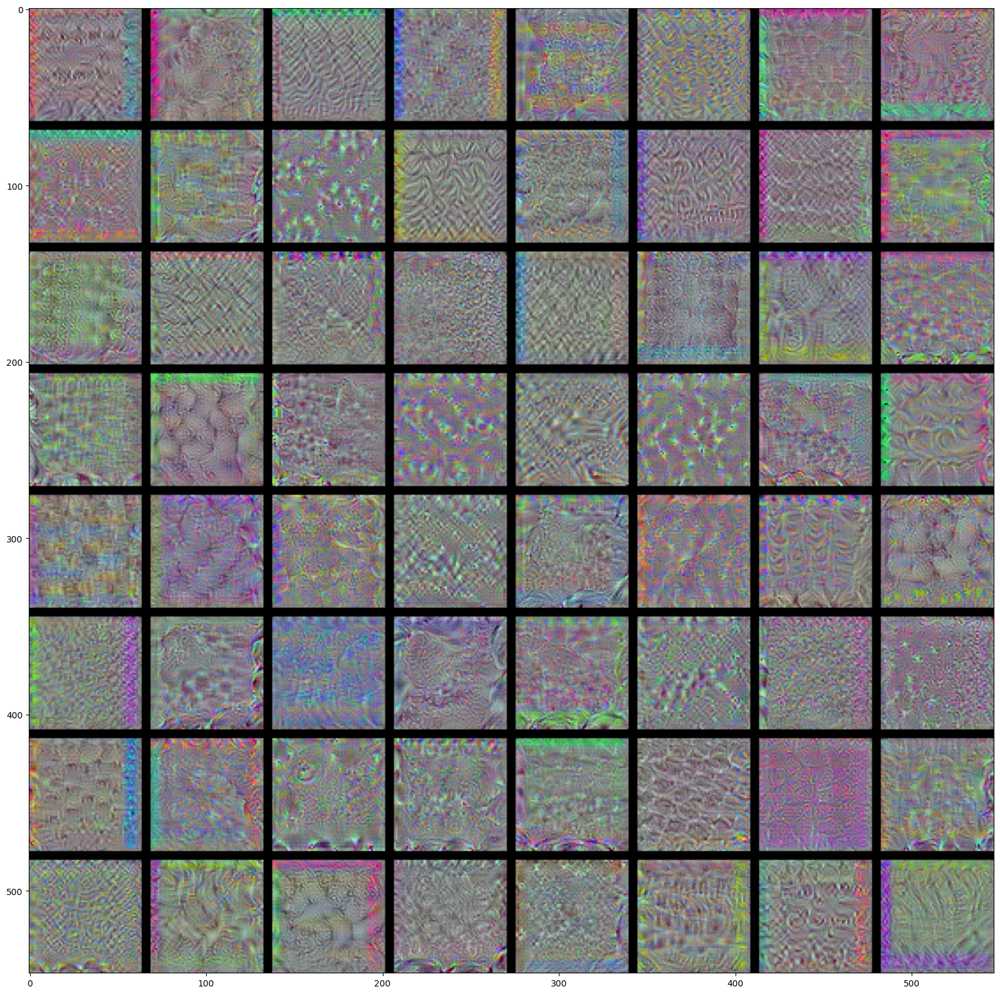

In [ ]:
for layer_name in ['conv1_conv', 'conv3_block3_2_conv']:
    size = 64
    margin = 5

    results = np.zeros((8 * size + 7 * margin, 8 * size + 7 * margin, 3))

    for i in range(8):
        for j in range(8):
            filter_img = generate_pattern(layer_name, i + (j * 8), size=size)

            horizontal_start = i * size + i * margin
            horizontal_end = horizontal_start + size
            vertical_start = j * size + j * margin
            vertical_end = vertical_start + size
            results[horizontal_start: horizontal_end, vertical_start: vertical_end, :] = filter_img

    plt.figure(figsize=(20, 20))
    plt.imshow((results * 255).astype(np.uint8))
    plt.show()

#### Last Conv Block
To avoid kernel crash

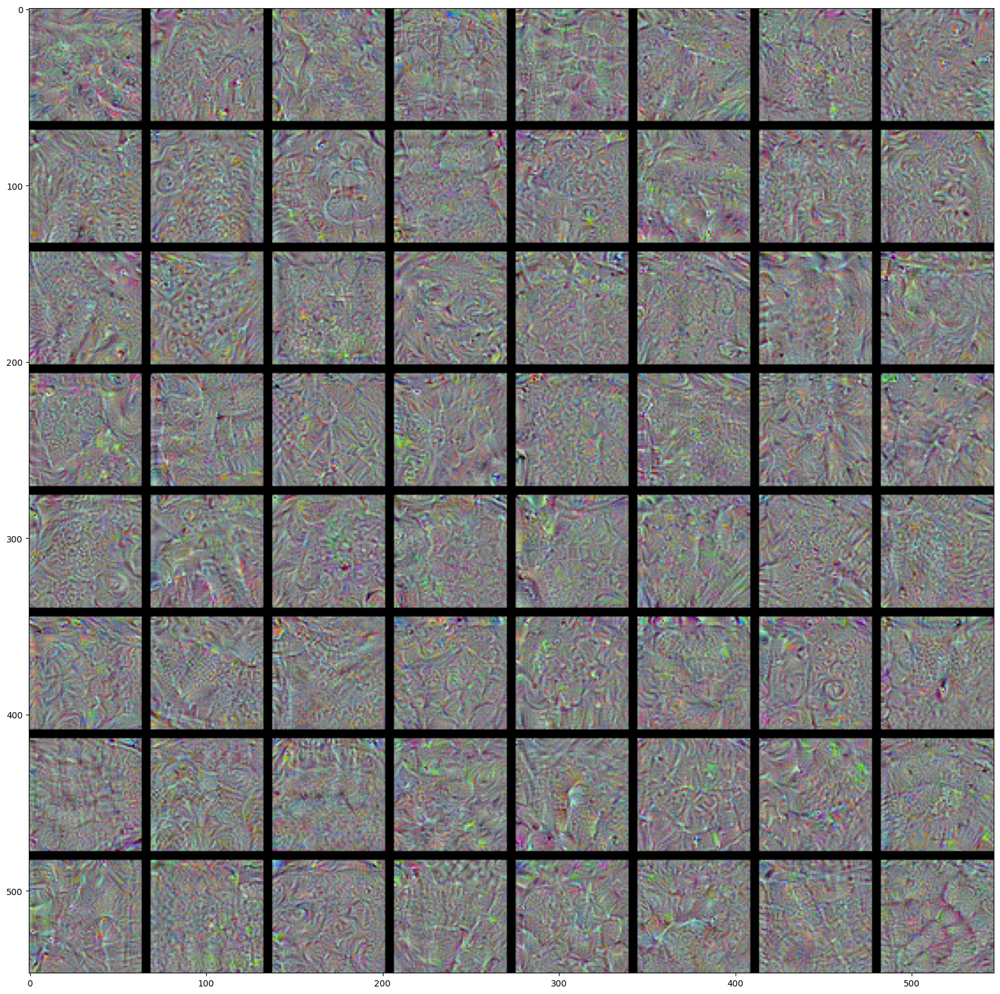

In [ ]:
for layer_name in ['conv5_block3_3_conv']:
    size = 64
    margin = 5

    # This a empty (black) image where we will store our results.
    results = np.zeros((8 * size + 7 * margin, 8 * size + 7 * margin, 3))

    for i in range(8):  # iterate over the rows of our results grid
        for j in range(8):  # iterate over the columns of our results grid
            # Generate the pattern for filter `i + (j * 8)` in `layer_name`
            filter_img = generate_pattern(layer_name, i + (j * 8), size=size)

            # Put the result in the square `(i, j)` of the results grid
            horizontal_start = i * size + i * margin
            horizontal_end = horizontal_start + size
            vertical_start = j * size + j * margin
            vertical_end = vertical_start + size
            results[horizontal_start: horizontal_end, vertical_start: vertical_end, :] = filter_img

    # Display the results grid
    plt.figure(figsize=(20, 20))
    plt.imshow((results * 255).astype(np.uint8))
    plt.show()

### PS1.B Visualize Heatmaps

In [ ]:
# import tensorflow as tf
transfer_model = tf.keras.models.load_model('transfer_resnet50_2b_aug1.h5')
transfer_model.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 conv1_pad (ZeroPadding2D)   (None, 230, 230, 3)          0         ['input_1[0][0]']             
                                                                                                  
 conv1_conv (Conv2D)         (None, 112, 112, 64)         9472      ['conv1_pad[0][0]']           
                                                                                                  
 conv1_bn (BatchNormalizati  (None, 112, 112, 64)         256       ['conv1_conv[0][0]']          
 on)                                                                                        

In [ ]:
import numpy as np

# The local path to our target image
#img_path = 'creative_commons_elephant.jpg'
# img_path = 'refs/dog_1.jpg'
img_path = 'refs/ship_1.jpg'

im_size = 224

# `img` is a PIL image of size 224x224
img = tf.keras.utils.load_img(img_path, target_size=(im_size, im_size))

# `x` is a float32 Numpy array of shape (224, 224, 3)
img_tensor = tf.keras.utils.img_to_array(img)

# We add a dimension to transform our array into a "batch"
# of size (1, 224, 224, 3)
img_tensor = np.expand_dims(img_tensor, axis=0)

img_tensor /= 255.

# # Its shape is (1, 224, 224, 3)
print(img_tensor.shape)

(1, 224, 224, 3)


In [ ]:
preds = transfer_model.predict(img_tensor)
def custom_decode_predictions(predictions, top=5, class_names=None):
    if class_names is None:
        class_names = [str(i) for i in range(predictions.shape[-1])]

    results = []
    for pred in predictions:
        top_indices = pred.argsort()[-top:][::-1]
        decoded_preds = [(class_names[i], pred[i]) for i in top_indices]
        results.append(decoded_preds)

    return results

# classes = ['ship']
classes = ['airplane', 'automobile', 'bird', 'cat', 'dog', 'deer', 'frog', 'horse', 'ship', 'truck']

print('Predicted:', custom_decode_predictions(preds, top=5, class_names=classes))


Predicted: [[('airplane', 0.9999543)]]


#### Chosen Layers

In [ ]:
img_path
layers_to_visualize = [transfer_model.get_layer('conv1_relu'),
                       transfer_model.get_layer('conv3_block2_2_relu'),
                       transfer_model.get_layer('conv5_block3_2_relu')]

for layer in layers_to_visualize:
    print(layer.name)

conv1_relu
conv3_block2_2_relu
conv5_block3_2_relu


In [ ]:
import cv2

def overlay_heatmap(heatmap, img_path, alpha=0.4):
    img = cv2.imread(img_path)

    hmap = heatmap

    # Resize the heatmap to the size of the original image
    heatmap = cv2.resize(heatmap, (img.shape[1], img.shape[0]))

    # Normalize the heatmap
    heatmap = (heatmap - np.min(heatmap)) / (np.max(heatmap) - np.min(heatmap))

    # Apply a colormap to the heatmap
    heatmap = cv2.applyColorMap(np.uint8(255 * heatmap), cv2.COLORMAP_JET)

    # Superimpose the heatmap on the original image
    superimposed_img = heatmap * alpha + img


    fig, axes = plt.subplots(1, 3, figsize=(12, 8))


    # Display the heatmap in the second subplot
    axes[0].imshow(hmap)
    axes[0].set_title('Heatmap')
    axes[0].axis('off')

    # Display the heatmap in the second subplot
    axes[1].imshow(heatmap, cmap='jet')
    axes[1].set_title('Heatmap Normalized')
    axes[1].axis('off')


    # Display the superimposed image in the first subplot
    axes[2].imshow(cv2.cvtColor(np.uint8(superimposed_img), cv2.COLOR_BGR2RGB))
    axes[2].set_title('Superimposed Image')
    axes[2].axis('off')


    plt.show()


    # plt.imshow(cv2.cvtColor(np.uint8(superimposed_img), cv2.COLOR_BGR2RGB))
    # plt.axis('off')
    # plt.show()

#### First Layer Heatmap

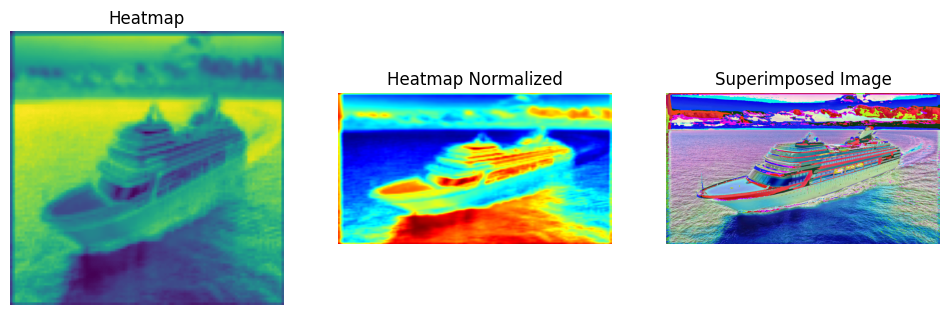

In [ ]:
# This is the "ship" entry in the prediction vector
ship_output = transfer_model.output

# The is the output feature map of the `conv3_block2_2_relu` layer,
# the first convolutional layer in ResNet50
first_conv_layer = transfer_model.get_layer('conv1_relu')

# This is the gradient of the "dog" class with regard to
# the output feature map of `conv5_block3_3_conv`
grads = K.gradients(ship_output, first_conv_layer.output)[0]

# This is a vector of shape (512,), where each entry
# is the mean intensity of the gradient over a specific feature map channel
pooled_grads = K.mean(grads, axis=(0, 1, 2))

# This function allows us to access the values of the quantities we just defined:
# `pooled_grads` and the output feature map of `block5_conv3`,
# given a sample image
iterate = K.function([transfer_model.input], [pooled_grads, first_conv_layer.output[0]])

# These are the values of these two quantities, as Numpy arrays,
# given our sample image of two elephants
pooled_grads_value, conv_layer_output_value = iterate([img_tensor])

# We multiply each channel in the feature map array
# by "how important this channel is" with regard to the elephant class
for i in range(64):
    conv_layer_output_value[:, :, i] *= pooled_grads_value[i]

# The channel-wise mean of the resulting feature map
# is our heatmap of class activation
heatmap_first = np.mean(conv_layer_output_value, axis=-1)

overlay_heatmap(heatmap_first, img_path)

#### Middle Layer Heatmap

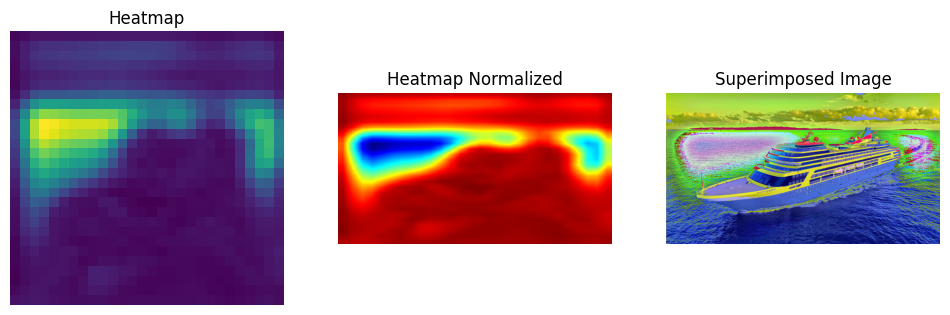

In [ ]:
# This is the "ship" entry in the prediction vector
ship_output = transfer_model.output

# The is the output feature map of the `conv3_block2_2_relu` layer,
# the first convolutional layer in ResNet50
middle_conv_layer = transfer_model.get_layer('conv3_block2_2_relu')

# This is the gradient of the "dog" class with regard to
# the output feature map of `conv5_block3_3_conv`
grads = K.gradients(ship_output, middle_conv_layer.output)[0]

# This is a vector of shape (512,), where each entry
# is the mean intensity of the gradient over a specific feature map channel
pooled_grads = K.mean(grads, axis=(0, 1, 2))

# This function allows us to access the values of the quantities we just defined:
# `pooled_grads` and the output feature map of `block5_conv3`,
# given a sample image
iterate = K.function([transfer_model.input], [pooled_grads, middle_conv_layer.output[0]])

# These are the values of these two quantities, as Numpy arrays,
# given our sample image of two elephants
pooled_grads_value, conv_layer_output_value = iterate([img_tensor])

# We multiply each channel in the feature map array
# by "how important this channel is" with regard to the elephant class
for i in range(64):
    conv_layer_output_value[:, :, i] *= pooled_grads_value[i]

# The channel-wise mean of the resulting feature map
# is our heatmap of class activation
heatmap_middle = np.mean(conv_layer_output_value, axis=-1)

overlay_heatmap(heatmap_middle, img_path)

#### Last Layer Heatmap

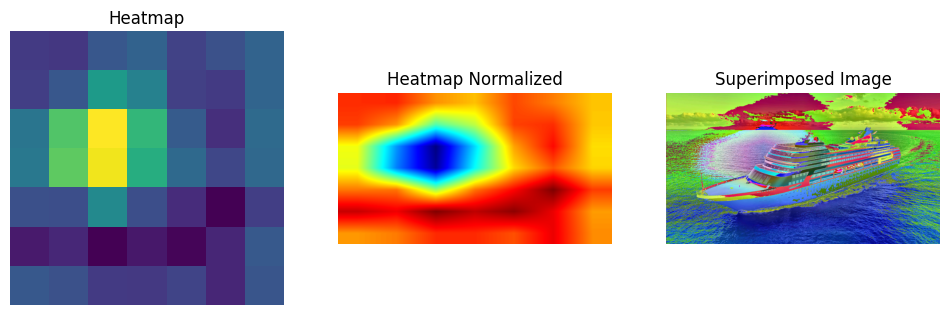

In [ ]:
# This is the "ship" entry in the prediction vector
ship_output = transfer_model.output

# The is the output feature map of the `conv3_block2_2_relu` layer,
# the first convolutional layer in ResNet50
last_conv_layer = transfer_model.get_layer('conv5_block3_2_relu')

# This is the gradient of the "dog" class with regard to
# the output feature map of `conv5_block3_3_conv`
grads = K.gradients(ship_output, last_conv_layer.output)[0]

# This is a vector of shape (512,), where each entry
# is the mean intensity of the gradient over a specific feature map channel
pooled_grads = K.mean(grads, axis=(0, 1, 2))

# This function allows us to access the values of the quantities we just defined:
# `pooled_grads` and the output feature map of `block5_conv3`,
# given a sample image
iterate = K.function([transfer_model.input], [pooled_grads, last_conv_layer.output[0]])

# These are the values of these two quantities, as Numpy arrays,
# given our sample image of two elephants
pooled_grads_value, conv_layer_output_value = iterate([img_tensor])

# We multiply each channel in the feature map array
# by "how important this channel is" with regard to the elephant class
for i in range(64):
    conv_layer_output_value[:, :, i] *= pooled_grads_value[i]

# The channel-wise mean of the resulting feature map
# is our heatmap of class activation
heatmap_last = np.mean(conv_layer_output_value, axis=-1)

overlay_heatmap(heatmap_last, img_path)

## END